# Unlocking Insights into London's Hotel Market
## *Based on data from Booking.com*
**Candidate Number:** 54454, 49823, 53900

## Table of Contents
* [1. Introduction](#1)
* [2. Data Acquisition and Description](#2)
    * [2.1 Hotel's Data (Main Dataset)](#2.1)
    * [2.2 Hotel Review Data](#2.2)
    * [2.3 Other Public Data](#2.3)
* [3. Data Preparation/Cleaning (Main Dataset)](#3)
    * [3.1 Dataset Overview](#3.1)
    * [3.2 Removing redundant columns](#3.2)
    * [3.3 Drop duplicates](#3.3)
    * [3.4 Clean individual columns and deal with NaN values](#3.4)
    * [3.5 Clean zip and district](#3.5)
* [4. Data Analysis](#4)
    * [4.1 Hotel Accommodations by Star Ratings and Property Types](#4.1)
    * [4.2 Hotel Pricing and Detection of Outliers](#4.2)
    * [4.3 Correlation Analysis](#4.3)
    * [4.4 Geographical Analysis](#4.4)
    * [4.5 Affordable and Convenient Location Properties](#4.5)
    * [4.6 Hotel Review Analysis](#4.6)
    * [4.7 Machine Learning Models for Hotel Price Prediction](#4.7)
* [5. Conclusion](#5)
* [Reference](#6)
---

## 1. Introduction <a id = '1'></a>

The tourism industry plays a significant role in the global economy, and the hotel and accommodation sector is a critical part of it. According to [House of Commons Library (2022)](#r4), just before Covid-19, the hospitality industry contributed $59.3 billion or 3%, to the UK's overall economic output. In each country and region, around 5% of enterprises were in the hospitality industry. London, as one of the most visited cities, has a thriving hotel and accommodation industry. The industry's growth has been fueled by London's status as a leading global financial centre and a top travel destination, making it an exciting and dynamic market to study. 

The hotel and accommodation industry is highly competitive, with a wide range of service providers offering various types of accommodations at different price points. As such, industry players must understand consumer preferences and market trends to remain competitive and profitable. This study aims to explore and analyze the London hotel and accommodation market to gain insights into consumer behaviour, market dynamics, and trends, using data from [Booking.com](https://www.booking.com/city/gb/london.html?aid=1610684;label=london-usRTirXfRZu_HYFiA_E8pQS380965834292:pl:ta:p1:p2:ac:ap:neg:fi:tiaud-146342137510:kwd-10813050762:lp1002316:li:dec:dm:ppccp=UmFuZG9tSVYkc2RlIyh9YfqnDqqG8nt10AsofPfvtt0;ws=&gclid=Cj0KCQiAutyfBhCMARIsAMgcRJSdzXvjqFnR2rKC-eL3P_GPvF7fKS-JyIjxcba_vcaiImvuyTuWxJcaAlxzEALw_wcB), a leading online travel agency. Some initial questions this report aims to answer include:

* What is the distribution of hotel properties in London by location, type, and star rating?
* Is there price trends and price ranges of hotels and accommodations in London?
* How do consumer reviews and ratings, and preferences affect the hotel market in London?
* Can we build a machine-learning model to predict the price?

In terms of originality, several studies have been conducted on the London hotel and accommodation market. However, this study is unique in that it analyzes a dataset from the perspective of the world's leading online travel agency to gain insights into consumer behaviour, pricing trends, and market dynamics. This study's originality lies in its use of a diverse set of variables, including hotel information, consumer reviews and public open-source data, to gain a comprehensive picture of the market.

---

## 2. Data Acquisition and Description <a id = '2'></a>

This project uses quite comprehensive data, all of which are stored in the `data` folder of the current working directory. Some of them are obtained through API and some are from official channels. This section will give a brief introduction to each of these.

In [2]:
import os
#num_data = len(os.listdir('data')[1:])
data_lst = os.listdir('data')[1:] # [1:] is used to hide '.DS_Store'
print(f'Here is a list of data files/folder used in this project: \n {data_lst}')

Here is a list of data files/folder used in this project: 
 ['NSPL21_NOV_2022_UK.csv', 'data.json', 'LA_UA names and codes UK as at 04_21.csv', 'hotel_ids_for_reviews.json', 'london_boroughs.json', 'review_data.json', 'London Area Profiles']


### 2.1 Hotel's Data (Main Dataset) <a id = '2.1'></a>
*Collected on 28 Jan 2023*

The main dataset used in this project consists of hotel data obtained from the [Booking.com API available on RapidAPI](https://rapidapi.com/tipsters/api/booking-com/details). Detailed process of how we obtain the data could be refered at: `ST445Project_DataAcquisition.ipynb` in the current working directory.

The data obtained is stored at `data` folder with name `data.json`.

It includes hotel listings in London. Each hotel listing provides information such as the hotel name, star rating, property type, room types, availability for a specified check-in and check-out date, review scores rated by guests, pricing information, etc. It also includes information on the hotel's geographical location, such as the district and zip code. More information about the features of our data can be found in the [Data Preparation/Cleaning (Main Dataset) ](#3) section.

The data is organized in a JSON format and consists of a list of hotel dictionaries, with each dictionary containing multiple key-value pairs that correspond to the hotel's various attributes. 

### 2.2 Hotel Review Data <a id = '2.2'></a>
*Collected on 18 Feb 2023*

After finishing their stay, guests were welcomed to write reviews about "what did you like" and "what didn't you like". They correspond to positive and negative reviews respectively.

The hotel review data included 10000 rows of reviews (both positive and negative reviews) from 400 hotels (25 rows of reviews per hotel). It was collected on 18 February. And it was collected by the same [API](https://rapidapi.com/tipsters/api/booking-com/details) through the Reviews of the hotel endpoint.

The `hotel_ids_for_reviews.json` file includes a `hotel_id` list of these 400 hotels. It was used to retrieve hotel review data through API (hotel_id is a parameter in an API call). More detailed information/codes about how to select these 400 hotels can be found at the beginning of the [Hotel Review Analysis](#4.6) of this notebook.

The code (including how to update API key) used to collect the hotel review data through API can be found in another notebook called `ST445Project_ReviewDataAcquisition.ipynb`.

The data was stored at `data` folder with name `review_data.json`. It could provide valuable insights into the customer experience at each hotel.

### 2.3 Other Public Data <a id = '2.3'></a>

There are also other datasets involved for cleaning/analysis purposes. They are all obtained through public channels:

1. `NSPL21_NOV_2022_UK.csv:` This dataset contains the National Statistics Postcode Lookup (NSPL) for the UK as of November 2022. It provides a comprehensive list of postcodes in the UK, along with their corresponding administrative geography codes, such as the local authority, county, and region. The data can be downloaded [here](https://geoportal.statistics.gov.uk/datasets/national-statistics-postcode-lookup-2021-census-november-2022/about).

2. `LA_UA names and codes UK as at 04_21.csv:` This dataset contains the names and codes for all local authorities in the UK as of April 2021. It includes the local authority or unitary authority name, the local authority or unitary authority code, and the region that it belongs to. The data can be downloaded [here](https://geoportal.statistics.gov.uk/datasets/national-statistics-postcode-lookup-2021-census-november-2022/about).

3. `london_boroughs.json:` This dataset contains the geographical boundaries for the 32 London boroughs in `GeoJSON` format. It is used for geographical analysis. The data can be downloaded [here](https://skgrange.github.io/www/data/london_boroughs.json).

4. `London Area Profiles (folder):` This dataset contains various socio-economic indicators for different boroughs in London. It is used to provide additional context and insights for the analysis of the hotel data. The data can be downloaded [here](https://data.london.gov.uk/london-area-profiles/).

---

## 3. Data Preparation/Cleaning (Main Dataset) <a id = '3'></a>

### 3.1 Dataset Overview <a id = '3.1'></a>

In [3]:
# Import necessary libraries
import json
import pandas as pd
import numpy as np
import warnings
warnings.simplefilter('ignore')

/opt/anaconda3/lib/python3.8/site-packages/pandas/core/computation/expressions.py:20: UserWarning: Pandas requires version '2.7.3' or newer of 'numexpr' (version '2.7.1' currently installed).
  from pandas.core.computation.check import NUMEXPR_INSTALLED


In [4]:
# Convert json file into dataframe
df = pd.read_json('data/data.json')
df.head()

,distance_to_cc,cant_book,country_trans,block_ids,preferred_plus,longitude,cc_required,is_beach_front,review_nr,native_ads_tracking,...,native_ad_id,max_photo_url,max_1440_photo_url,has_swimming_pool,urgency_message,ribbon_text,booking_home,has_free_parking,cpc_non_trader_copy,external_reviews
0,9.40,NaN,United Kingdom,[415528308_165993040_0_2_0],0,-0.006791,1,0,1816.0,,...,,https://cf.bstatic.com/xdata/images/hotel/max1...,https://cf.bstatic.com/xdata/images/hotel/1440...,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3.65,NaN,United Kingdom,[21729508_206153586_0_42_0],1,-0.178233,1,0,5938.0,,...,,https://cf.bstatic.com/xdata/images/hotel/max1...,https://cf.bstatic.com/xdata/images/hotel/1440...,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,4.15,NaN,United Kingdom,[3173_350794506_2_2_0],1,-0.186629,1,0,557.0,,...,,https://cf.bstatic.com/xdata/images/hotel/max1...,https://cf.bstatic.com/xdata/images/hotel/1440...,1.0,NaN,NaN,NaN,NaN,NaN,NaN
3,4.05,NaN,United Kingdom,[59084001_237143439_0_2_0],1,-0.077537,1,0,2306.0,,...,,https://cf.bstatic.com/xdata/images/hotel/max1...,https://cf.bstatic.com/xdata/images/hotel/1440...,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,3.80,NaN,United Kingdom,[17937601_202279822_0_42_0],0,-0.180861,1,0,2719.0,,...,,https://cf.bstatic.com/xdata/images/hotel/max1...,https://cf.bstatic.com/xdata/images/hotel/1440...,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
df.head(3)

,distance_to_cc,cant_book,country_trans,block_ids,preferred_plus,longitude,cc_required,is_beach_front,review_nr,native_ads_tracking,...,native_ad_id,max_photo_url,max_1440_photo_url,has_swimming_pool,urgency_message,ribbon_text,booking_home,has_free_parking,cpc_non_trader_copy,external_reviews
0,9.40,NaN,United Kingdom,[415528308_165993040_0_2_0],0,-0.006791,1,0,1816.0,,...,,https://cf.bstatic.com/xdata/images/hotel/max1...,https://cf.bstatic.com/xdata/images/hotel/1440...,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3.65,NaN,United Kingdom,[21729508_206153586_0_42_0],1,-0.178233,1,0,5938.0,,...,,https://cf.bstatic.com/xdata/images/hotel/max1...,https://cf.bstatic.com/xdata/images/hotel/1440...,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,4.15,NaN,United Kingdom,[3173_350794506_2_2_0],1,-0.186629,1,0,557.0,,...,,https://cf.bstatic.com/xdata/images/hotel/max1...,https://cf.bstatic.com/xdata/images/hotel/1440...,1.0,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
df.columns

Index(['distance_to_cc', 'cant_book', 'country_trans', 'block_ids',
       'preferred_plus', 'longitude', 'cc_required', 'is_beach_front',
       'review_nr', 'native_ads_tracking', 'checkout', 'hotel_id', 'latitude',
       'selected_review_topic', 'native_ads_cpc', 'hotel_name_trans',
       'address', 'composite_price_breakdown', 'genius_discount_percentage',
       'is_geo_rate', 'in_best_district', 'is_genius_deal', 'city_name_en',
       'class', 'accommodation_type_name', 'district', 'city_in_trans',
       'preferred', 'id', 'distance', 'matching_units_configuration',
       'distance_to_cc_formatted', 'is_no_prepayment_block', 'price_breakdown',
       'city', 'review_recommendation', 'is_wholesaler_candidate',
       'city_trans', 'cc1', 'distances', 'hotel_facilities', 'main_photo_url',
       'currency_code', 'hotel_name', 'main_photo_id', 'timezone', 'badges',
       'districts', 'is_smart_deal', 'default_language', 'currencycode',
       'updated_checkin', 'type', 'soldou

### 3.2 Removing redundant columns <a id = '3.2'></a>

First of all, we did some handy work by filtering out **27** out of **90** features, which we think might be useful for later analysis.

In [7]:
df1 = df[['hotel_name','hotel_id','address','class','accommodation_type_name','district',
        'zip','distance_to_cc','review_nr','review_score_word',
        'is_free_cancellable','review_score','is_mobile_deal','mobile_discount_percentage','price_is_final',
        'preferred','hotel_has_vb_boost','preferred_plus', 'ribbon_text', 'cpc_non_trader_copy', 
        'urgency_message', 'has_free_parking', 'has_swimming_pool', 'longitude', 'latitude', 'unit_configuration_label',
        'min_total_price']]

df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1813 entries, 0 to 1812
Data columns (total 27 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   hotel_name                  1813 non-null   object 
 1   hotel_id                    1813 non-null   int64  
 2   address                     1813 non-null   object 
 3   class                       1813 non-null   int64  
 4   accommodation_type_name     1813 non-null   object 
 5   district                    1813 non-null   object 
 6   zip                         1813 non-null   object 
 7   distance_to_cc              1812 non-null   float64
 8   review_nr                   1653 non-null   float64
 9   review_score_word           1813 non-null   object 
 10  is_free_cancellable         1813 non-null   int64  
 11  review_score                1553 non-null   float64
 12  is_mobile_deal              1813 non-null   int64  
 13  mobile_discount_percentage  1813 

Some of the features may not be as intuitive by glancing at its name, detailed explaination is given:

| Feature | Comment |
| --- | --- |
| `distance_to_cc` | Distance to city centre (in km, round to 0.05) |
|`preferred` |[Preferred Partner Programme](https://partner.booking.com/en-gb/help/growing-your-business/increase-revenue/all-you-need-know-about-preferred-partner-programme) is an exclusive programme that gives greater visibility to the top 30% of partners
|`preferred_plus` |[Preferred Plus](https://partner.booking.com/en-gb/help/growing-your-business/increase-revenue/all-you-need-know-about-preferred-plus) is the premium tier of Preferred Partner Programme
|`hotel_has_vb_boost` |[Visibility Booster](https://partner.booking.com/en-gb/help/growing-your-business/increase-revenue/all-you-need-know-about-visibility-booster) is a marketing tool which allows partners to increase their visibility.|
|`review_nr` |Number of reviews
|`class`| Star rating, ranging from unrated to five-star hotels
|`has_free_parking`|Has free parking or not
|`review_score_word`|Review score word (e.g., Very good, Good)
|`review_score` |Review score (out of 10)
|`is_mobile_deal` |Has mobile deal or not 
|`mobile_discount_percentage`|Discount if booked by mobile
|`price_is_final`|Is the price shown the final price
|**`min_total_price`** | Minimum price for any room types for a give period of stay
|`ribbon_text` |Breakfast included
|`urgency_message`|Limited rooms remaining (e.g. `Only 1 left at this price on Booking.com`)
|`cpc_non_trader_copy` |Whether the property is professional/[private host](https://partner.booking.com/en-gb/help/legal-security/policies-local-laws/mandatory-host-type-professionalprivate-assessment)
|`unit_configuration_label` | room type, info about the room

### 3.3 Drop duplicates <a id = '3.3'></a>

Some columns in the dataframe are in unhashable data types. Before dropping duplicates, we need to transform them to make sure their values are comparable.

In [8]:
df1 = df1.astype({"hotel_name": str,         
                  "address": str,
                  "accommodation_type_name": str,
                  "district": str,
                  "zip": str,
                  "review_score_word": str,
                  "ribbon_text": str,
                  "cpc_non_trader_copy": str, 
                  "urgency_message": str
                  })

In [9]:
df1 = df1.drop_duplicates()
df1.reset_index(drop=True, inplace=True) 

In [10]:
df1

,hotel_name,hotel_id,address,class,accommodation_type_name,district,zip,distance_to_cc,review_nr,review_score_word,...,preferred_plus,ribbon_text,cpc_non_trader_copy,urgency_message,has_free_parking,has_swimming_pool,longitude,latitude,unit_configuration_label,min_total_price
0,The Stratford Hotel London,4155283,20 International Way Olympic Park,5,Hotel,Newham,E20 1FD,9.40,1816.0,Very good,...,0,nan,nan,nan,NaN,NaN,-0.006791,51.545301,Standard Double Room<br/><b>Hotel room</b>: 1 bed,177.01
1,The Chilworth London Paddington,217295,"55 Westbourne Terrace, Paddington, London",5,Hotel,Westminster Borough,W2 3UY,3.65,5938.0,Good,...,1,nan,nan,nan,NaN,NaN,-0.178233,51.515154,Compact Double Room<br/><b>Hotel room</b>: 1 bed,184.50
2,Milestone Hotel Kensington,123081,1 Kensington Court,5,Hotel,Kensington and Chelsea,W8 5DL,4.15,557.0,Superb,...,1,nan,nan,nan,NaN,1.0,-0.186629,51.502080,Superior Queen Room<br/><b>Room with shared ba...,344.25
3,One Hundred Shoreditch,590840,100 Shoreditch High Street,5,Hotel,Hackney,E1 6JQ,4.05,2306.0,Fabulous,...,1,nan,nan,nan,NaN,NaN,-0.077537,51.525664,Studio<br/><b>Hotel room</b>: 1 bed,260.10
4,"Inhabit, Queen's Gardens",179376,1-2 Queens Garden,5,Hotel,Westminster Borough,W2 3BA,3.80,2719.0,Very good,...,0,nan,nan,nan,NaN,NaN,-0.180861,51.514151,Superior Double Room<br/><b>Hotel room</b>: 1 bed,183.60
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1793,St Christopher's Inn Oasis - London Bridge - F...,1342523,163 Borough High Street,0,Hostel,Southwark,SE1 1HR,2.55,352.0,Good,...,0,nan,nan,nan,NaN,NaN,-0.092107,51.502705,Bed in 14-Bed Female Dormitory Room<br/><b>2 b...,49.76
1794,The Queens Hostel,1884991,121 South Africa road,0,Hostel,Hammersmith and Fulham,W12 7PA,7.15,856.0,Good,...,0,nan,nan,nan,NaN,NaN,-0.230403,51.510508,Single Bed in Mixed Dormitory Room<br/><b>2 be...,50.00
1795,Cade Castle - Tulse Hill,9310297,191 cade house,0,Homestay,Lambeth,SW2 3BS,7.50,8.0,Very good,...,0,nan,nan,nan,NaN,NaN,-0.107227,51.441241,Budget Double Room<br/>2 beds,165.00
1796,prospect hill,3264378,Flat 23 Crosbie House Prospect Hill Road Walth...,0,Homestay,Walthamstow,E17 3EP,12.10,34.0,Passable,...,0,nan,Managed by a private host,nan,NaN,NaN,-0.009350,51.587344,2 beds,70.00


In [11]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1798 entries, 0 to 1797
Data columns (total 27 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   hotel_name                  1798 non-null   object 
 1   hotel_id                    1798 non-null   int64  
 2   address                     1798 non-null   object 
 3   class                       1798 non-null   int64  
 4   accommodation_type_name     1798 non-null   object 
 5   district                    1798 non-null   object 
 6   zip                         1798 non-null   object 
 7   distance_to_cc              1797 non-null   float64
 8   review_nr                   1640 non-null   float64
 9   review_score_word           1798 non-null   object 
 10  is_free_cancellable         1798 non-null   int64  
 11  review_score                1542 non-null   float64
 12  is_mobile_deal              1798 non-null   int64  
 13  mobile_discount_percentage  1798 

### 3.4 Clean individual columns and deal with NaN values <a id = '3.4'></a>

In [12]:
df1['has_free_parking'] = df1['has_free_parking'].fillna(0)
df1['has_free_parking'] = df1['has_free_parking'].astype(int)

df1['has_swimming_pool'] = df1['has_swimming_pool'].fillna(0)
df1['has_swimming_pool'] = df1['has_swimming_pool'].astype(int)

df1['review_nr'] = df1['review_nr'].fillna(0)
df1['review_nr'] = df1['review_nr'].astype(int)

breakfast_included=[]
for i in range(len(df1)):
    if pd.isna(df1['ribbon_text'][i]):
        breakfast_included.append(0)
    else:
        breakfast_included.append(1)
        
is_private_host=[]
for i in range(len(df1)):
    if pd.isna(df1['cpc_non_trader_copy'][i]):
        is_private_host.append(0)
    else:
        is_private_host.append(1)
        
num_room_left=[]
for i in range(len(df1)):
    if df1['urgency_message'][i]=='Only 4 left at this price on Booking.com':
        num_room_left.append('4')
    elif df1['urgency_message'][i]=='Only 3 left at this price on Booking.com':
        num_room_left.append('3')
    elif df1['urgency_message'][i]=='Only 2 left at this price on Booking.com':
        num_room_left.append('2')
    elif df1['urgency_message'][i]=='Only 1 left at this price on Booking.com':
        num_room_left.append('1')
    else:
        num_room_left.append('4+')
        

There is information about the room type and the number of beds in the 'unit_configuration_label' column, which we think might be useful for further analysis. 

In [13]:
pd.set_option('max_colwidth', None)  #To display full texts in this column

df1[['unit_configuration_label']]

,unit_configuration_label
0,Standard Double Room<br/><b>Hotel room</b>: 1 bed
1,Compact Double Room<br/><b>Hotel room</b>: 1 bed
2,Superior Queen Room<br/><b>Room with shared bathroom</b>: 1 bed
3,Studio<br/><b>Hotel room</b>: 1 bed
4,Superior Double Room<br/><b>Hotel room</b>: 1 bed
...,...
1793,Bed in 14-Bed Female Dormitory Room<br/><b>2 beds in dormitories</b>: 2 beds
1794,Single Bed in Mixed Dormitory Room<br/><b>2 beds in dormitories</b>: 2 beds
1795,Budget Double Room<br/>2 beds
1796,2 beds


In [14]:
pd.reset_option('max_colwidth')

Here we can have a look at the values in the `unit_configuration_label` column. Basically, the related information about the number of beds are in the formats of  '((1\xa0bed)|(\d{1,2}\xa0beds)|(1 double or 2 singles))', in which we use regular expression pattern. For the room type, we can extract the texts before '\<br/>'.

Extract information about room types:

In [15]:
df1['room_type'] = df1['unit_configuration_label'].str.split('<br/>').str[0]

Extract information about the number of beds:

In [16]:
#Regular expression pattern with capturing groups for extracting info from the 'unit_configuration_label' column
pat = r'((1\xa0bed)|(\d{1,2}\xa0beds)|(1 double or 2 singles))' 
#Use pandas.Series.str method to extract the number of beds in each hotel
#For simplicity, it is reasonable to treat '1 double or 2 singles' as 1 bed
df1['num_of_bed'] = df1['unit_configuration_label'].str.extract(pat)[0].str.split().str[0]  

In [17]:
# If we want to keep the '1 double or 2 singles' as the number of beds: 

#df1['num_of_bed'] = df1['unit_configuration_label'].str.extract(r'((1\xa0bed)|(\d{1,2}\xa0beds))')[0].str.split().str[0] 
#df1.loc[~df1['unit_configuration_label'].str.extract(r'(1 double or 2 singles)')[0].isna(), 'num_of_bed']='1 double or 2 singles'

In [18]:
df2 = pd.DataFrame(list(zip(breakfast_included, is_private_host, num_room_left)),
               columns =['breakfast_included', 'is_private_host', 'num_room_left'])

In [19]:
df3 = pd.concat([df1, df2], axis=1)
df3 = df3.drop(columns=['ribbon_text', 'cpc_non_trader_copy', 'urgency_message'])

### 3.5 Clean `zip` and `district` <a id = '3.5'></a>

In [20]:
df3['zip'] = df3['zip'].str.strip()

In [21]:
df3['district'].value_counts()

Westminster Borough       482
Camden                    190
Kensington and Chelsea    169
Tower Hamlets             154
                           86
Southwark                  86
Hammersmith and Fulham     80
Newham                     77
Lambeth                    74
Wandsworth                 65
Islington                  53
Brent                      51
City of London             43
Hackney                    41
Greenwich                  30
Lewisham                   26
Golders Green              20
Ealing                     17
Acton                      16
Wimbledon                   9
Chiswick                    6
Stratford                   5
Walthamstow                 5
Mortlake                    4
Muswell Hill                4
Bayswater                   1
West End                    1
Shoreditch                  1
Barnes                      1
Sydenham                    1
Name: district, dtype: int64

Noticing that null values compromise a large part and some district notations are overlapping. (e.g., Acton forms part of Ealing), to be more precise in our analysis, here we convert the district notation to a more standardized local authority level from the [NSPL (National Statistics Postcode Lookup) database](https://geoportal.statistics.gov.uk/datasets/national-statistics-postcode-lookup-2021-census-november-2022/about).

In [22]:
# Load the national database containing each post code and its associate local authority.
pcd = pd.read_csv('data/NSPL21_NOV_2022_UK.csv') 

In [23]:
# This takes around 2min to run

pcd_not_found = []
local_authority = []

for i in range(len(df3['zip'])):
    code = list(df3['zip'])[i]
    laua = pcd[(pcd['pcd'] == code )| (pcd['pcd2'] == code)| (pcd['pcds'] == code)]['laua'].to_list()

    # Check if any postcodes cannot be found in the national database.
    if laua == []:
        pcd_not_found.append(i)

print('Number of instances not found: ', len(pcd_not_found))

pcd_not_found_lst = []

for i in pcd_not_found:
    pcd_not_found_lst.append(df3.loc[i]['zip'])

print('Anomalous data sample:', pcd_not_found_lst[:5])

Number of instances not found:  22
Anomalous data sample: ['W23AN', 'Ec3N 1AX', '', '', '']


This suggests that 22 postcodes cannot be found in the national database, either not recorded or misrecorded. We propose to use the `geopy` module to correct those anomalous data points [(GeeksforGeeks, 2022)](#r1).

In [24]:
# This takes around 2min to run

# import module and initialize API
import geopy
from geopy.geocoders import Nominatim
geolocator = Nominatim(user_agent="geoapiExercises")

# Re-locate the post code according to coordinates
pcd_corrected = []

for i in pcd_not_found:
    coord = (df3.loc[i]['latitude'], df3.loc[i]['longitude'])
    location = geolocator.reverse(coord)
    pcd_corrected.append(location.raw['address']['postcode'])

# Substitute the value into the dataframe
for index, value in enumerate(pcd_not_found):
    df3['zip'][value] = pcd_corrected[index]

# Repeat the process of locating postcode to local authority code
local_authority_code = []

for i in range(len(df3['zip'])):
    code = list(df3['zip'])[i]
    laua = pcd[(pcd['pcd'] == code )| (pcd['pcd2'] == code)| (pcd['pcds'] == code)]['laua'].to_list()
    local_authority_code = local_authority_code + laua

# Look-up code to authority name
local_authority_table = pd.read_csv('data/LA_UA names and codes UK as at 04_21.csv')

local_authority_name = []

for i in local_authority_code:
    name = local_authority_table['LAD21NM'][local_authority_table['LAD21CD'] == i].to_list()
    local_authority_name = local_authority_name + name

# Substitute the value into the dataframe
df3['district'] = local_authority_name
df3['district'].value_counts()

Westminster               489
Camden                    194
Kensington and Chelsea    164
Tower Hamlets             156
Southwark                  85
Hammersmith and Fulham     82
Newham                     77
Lambeth                    76
Wandsworth                 64
Islington                  55
Brent                      51
Hackney                    42
City of London             41
Ealing                     34
Barnet                     32
Greenwich                  31
Lewisham                   26
Waltham Forest             20
Redbridge                  17
Haringey                   17
Merton                     13
Hounslow                    8
Richmond upon Thames        5
Croydon                     4
Enfield                     4
Bromley                     3
Harrow                      2
Hillingdon                  2
Barking and Dagenham        2
Bexley                      1
Havering                    1
Name: district, dtype: int64

---
**The final cleaned dataset which will be analyzed later on is named as `df3`.**

In [25]:
df3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1798 entries, 0 to 1797
Data columns (total 29 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   hotel_name                  1798 non-null   object 
 1   hotel_id                    1798 non-null   int64  
 2   address                     1798 non-null   object 
 3   class                       1798 non-null   int64  
 4   accommodation_type_name     1798 non-null   object 
 5   district                    1798 non-null   object 
 6   zip                         1798 non-null   object 
 7   distance_to_cc              1797 non-null   float64
 8   review_nr                   1798 non-null   int64  
 9   review_score_word           1798 non-null   object 
 10  is_free_cancellable         1798 non-null   int64  
 11  review_score                1542 non-null   float64
 12  is_mobile_deal              1798 non-null   int64  
 13  mobile_discount_percentage  1798 

---

## 4. Data Analysis <a id = '4'></a>

In this Data Analysis section, we delve deeper into the wealth of information available on Booking.com to gain insights into the hotel industry in one of the world's most popular travel destinations, London. By analyzing data on hotel pricing, class ratings, location, and amenities, we aim to provide insights into the trends and patterns that shape the tourism industry in London.

Throughout this analysis, we will use a range of statistical techniques and visualization tools to uncover interesting relationships and trends in the data. Our goal is to provide a comprehensive picture of the hotel industry in London, from the types of properties available to the factors that influence pricing. Ultimately, we hope to offer valuable insights for anyone interested in understanding the dynamics of the London hotel market.

In [26]:
import glob
import seaborn as sns
import matplotlib.pyplot as plt
import folium
from folium import plugins, GeoJson
from branca import colormap as cm
%matplotlib inline
sns.set(style = 'darkgrid')

## 4.1 Hotel Accommodations by Star Ratings and Property Types <a id = '4.1'></a>
First of all, we provide an overview of the types of accommodations available in London hotel market, including hotels, apartments, and other property types. We also analyzes the distribution of star ratings among hotels in London, which can provide insights into the quality of services and amenities offered by different hotels. The key questions will be answered are:

* Analysis of the distribution of hotel star ratings, their prices and review scores.
* Is star rating a good indicator for customers to choose hotels? Does the unrated hotels indicate poor services/quality?
* Analysis of the distribution of hotel types, their prices and reviews.

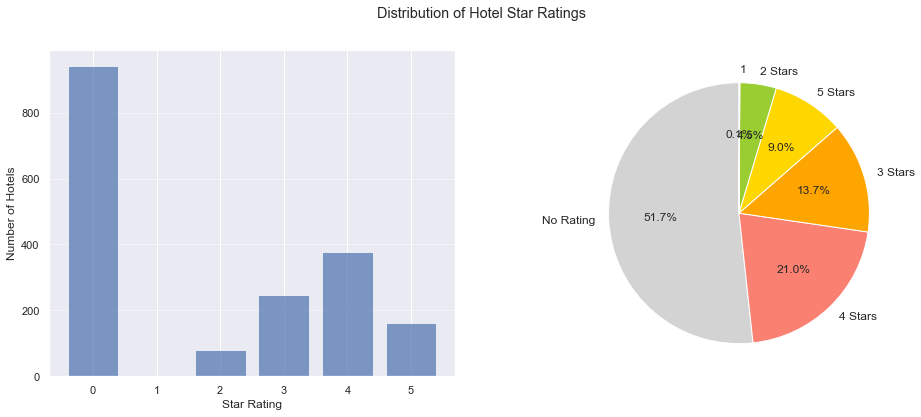

In [27]:
fig, ax = plt.subplots(1, 2, figsize=(16, 6))

# Create a barplot
class_counts = df['class'].value_counts()

ax[0].bar(class_counts.index, class_counts, alpha=0.7)
ax[0].set_xlabel('Star Rating')
ax[0].set_ylabel('Number of Hotels')
ax[0].grid(axis='y', alpha=0.5)

# Create a pie chart

# Create a list of labels
labels = ['No Rating', '4 Stars', '3 Stars', '5 Stars', '2 Stars', '1']

# Create a list of colors
colors = ['lightgray', 'salmon', 'orange', 'gold', 'yellowgreen', 'mediumseagreen']

# Create the pie chart with larger font size for percentage labels
ax[1].pie(df3['class'].value_counts(), labels=labels, colors=colors, 
        autopct='%1.1f%%', startangle=90, textprops={'fontsize': 12})

# Add a title
fig.suptitle('Distribution of Hotel Star Ratings');

Based on these plots, we can see that **more than half** of the hotels in London don't have a star rating. And for those hotels that have a star rating, most of them are **3, 4 and 5-star**. Only 4.5% of the hotels are 2-star rated and only 2 hotels are 1-star rated.


The dominance of 3, 4, and 5-star hotels in the city's market suggests that there is strong demand for high-quality accommodations among tourists visiting London. This is in line with the city's reputation as a top travel destination and a hub for business and cultural activities.

On the other hand, the fact that more than half of the hotels in London don't have a star rating is surprising, as it may suggest that a large proportion of the city's hotel market is either unregulated or doesn't meet the minimum criteria for a star rating. An intuitive guess is that many of these properties are small, independent establishments that don't have the resources or capacity to meet the requirements for a star rating. To validate our initial guess, we further break down those unrated properties into the analysis.

In [28]:
zero_star=df3[df3['class']==0]['accommodation_type_name'].value_counts()
one_star=df3[df3['class']==1]['accommodation_type_name'].value_counts()
two_star=df3[df3['class']==2]['accommodation_type_name'].value_counts()
three_star=df3[df3['class']==3]['accommodation_type_name'].value_counts()
four_star=df3[df3['class']==4]['accommodation_type_name'].value_counts()
five_star=df3[df3['class']==5]['accommodation_type_name'].value_counts()


# concatenate series into a dataframe and fill missing values with zeros
hotel_type_by_class = pd.concat([zero_star,one_star,two_star,three_star,four_star,five_star], axis=1, sort=True).fillna(0)
hotel_type_by_class.columns=['Unrated','1 star','2 star','3 star','4 star','5 star']
hotel_type_by_class.transpose()
hotel_type_by_class = hotel_type_by_class.astype(int)
hotel_type_by_class

,Unrated,1 star,2 star,3 star,4 star,5 star
Aparthotel,30,0,0,6,42,8
Apartment,529,0,0,7,23,10
Bed and breakfast,31,0,5,4,3,0
Boat,4,0,0,0,1,0
Campsite,1,0,0,0,0,0
Guest house,75,1,12,9,3,1
Holiday home,21,0,0,0,1,1
Homestay,88,0,0,1,0,0
Hostel,42,1,2,3,6,0
Hotel,92,0,59,209,297,141


We can see from the above table that more than half of the hotels in London don't have a star rating, they are apartments. It might be because those relatively small and independent apartments don't have the resources or desire to go through the process of obtaining a star rating. Or, maybe the criterion for apartment star rating is more strict than hotels, thus most of the apartments don't have a star rating.

To conclude, a rating can be a helpful guide for London travellers looking for a certain level of quality and amenities in their accommodation. However, it's also important to bear in mind that the lack of a star rating doesn't necessarily indicate poor quality, and there may be some hidden gems among unclassified hotels. Next, let's take a look at the price distribution by different star ratings.

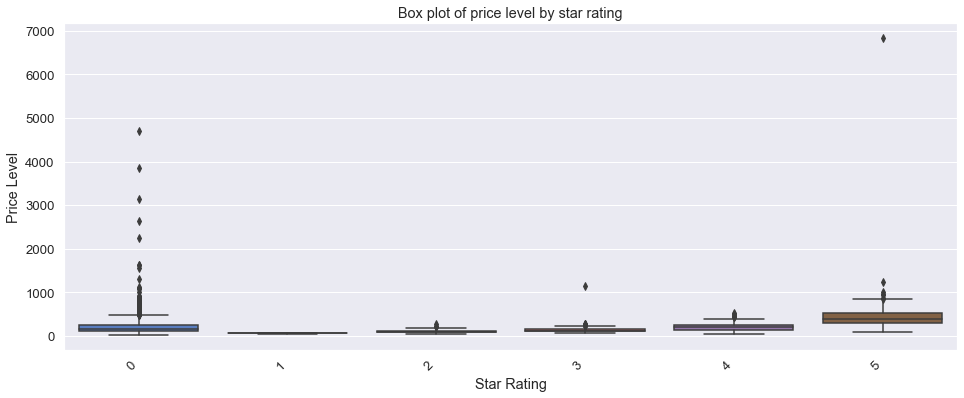

In [29]:
sns.set_style('whitegrid')

sns.set(font_scale=1.2)
plt.figure(figsize=(16,6))

sns.boxplot(x='class', y='min_total_price', data=df3, palette='muted')

plt.title('Box plot of price level by star rating')
plt.xlabel('Star Rating')
plt.ylabel('Price Level')

plt.xticks(rotation=45, ha='right');

It is noteworthy that from the boxplot above, the outliers distort the representation of the data distribution and make it difficult to interpret the summary statistics. They also affect the scaling of the axis and make it hard to compare different parts of the distribution. Therefore, to mitigate the negative impact of outliers on data visualization, prices are divided into 4 levels according to 25%, 50% and 75% quantiles. (Detailed analysis of outliers will be included in [the next section](#4.2).)

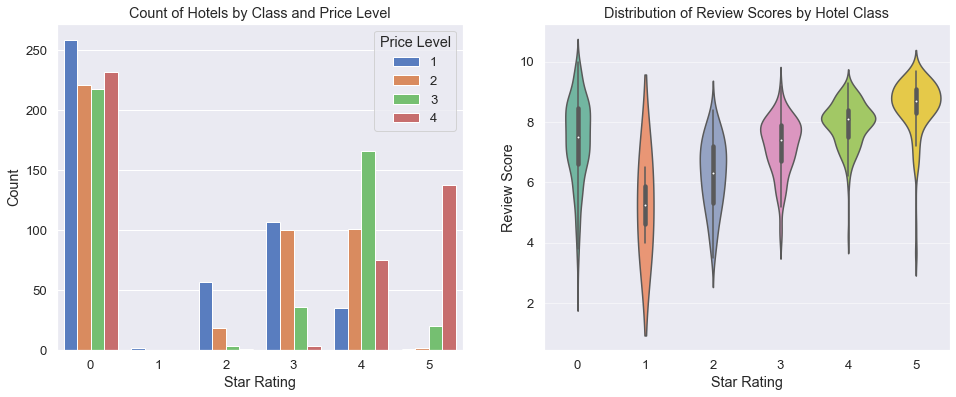

In [30]:
price_level = []
for i in range(len(df3)):
    if df3['min_total_price'][i]>df3['min_total_price'].quantile(q=0.75):
        price_level.append(4)
    elif 259>=df3['min_total_price'][i]>df3['min_total_price'].quantile(q=0.5):
        price_level.append(3)
    elif 165>=df3['min_total_price'][i]>df3['min_total_price'].quantile(q=0.25):
        price_level.append(2)
    else:
        price_level.append(1)
        
df_price_level = pd.DataFrame(price_level,columns=['price_level'])
df_price_level = pd.concat([df3, df_price_level], axis=1)

fig, ax = plt.subplots(1, 2, figsize=(16, 6))

# Plot the class rating with different price level

sns.countplot(data=df_price_level, hue='price_level', x='class', palette='muted', ax = ax[0])

ax[0].set_title('Count of Hotels by Class and Price Level')
ax[0].set_xlabel('Star Rating')
ax[0].set_ylabel('Count')
ax[0].legend(title='Price Level');

# Plot the class rating with review score

sns.violinplot(data=df3, x='class', y='review_score', palette='Set2', ax = ax[1])

ax[1].set_title('Distribution of Review Scores by Hotel Class')
ax[1].set_xlabel('Star Rating')
ax[1].set_ylabel('Review Score')

ax[1].grid(axis='y', alpha=0.5)

We can see from the left graph above that: 
* Prices of 5-star rating hotels are mostly in price level 4  
* Prices of 4-star rating hotels are mostly in price level 3
* Prices of 3-star rating hotels are mostly in price level 1 and level 2
* For these hotels that don't have a rating, prices are evenly distributed in all 4 price levels

We can see from the right-hand side violin plot above that:
* Hotels that with higher ratings usually have higher review scores. 
* The review score distribution for hotels without a rating has a similar median to 3-star rating hotels, but it has a larger range.
* The review score distributions for hotels with 3, 4, 5 and 0-star ratings are relatively left skewed.
* The review score distributions for hotels with 1 and 2-star ratings are relatively symmetric.


* If the review score can efficiently reveal the quality of hotels, then it's better to choose hotels with 3, 4 and 5-star ratings.

The evidence presented in the previous sections offers valuable insights for travellers seeking to book a hotel in London. One notable observation is that hotels with higher star ratings tend to charge higher prices and are marked with higher review scores due to their superior services and facilities, and vice versa. The fact that unrated hotels have evenly distributed prices and long-ranging review score distribution supports our explanation that the absence of a rating does not necessarily imply poor service or quality, but indicates the importance of carefully checking reviews and property details before booking.

Next, we break down the dataset by different kinds of **accommodation types** available on Booking.com to understand key differences among them.

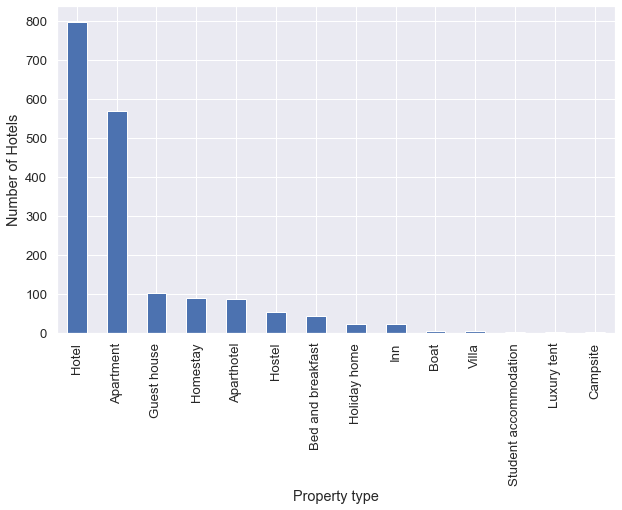

In [31]:
plt.figure(figsize=(10, 6));
df3.accommodation_type_name.value_counts().plot(kind='bar');
plt.xlabel('Property type');
plt.ylabel('Number of Hotels');

In [32]:
property_by_type = pd.pivot_table(df3, index = ['accommodation_type_name'],
               values = ['min_total_price', 'review_score', 'hotel_name'], 
               aggfunc = {'min_total_price': np.mean, 'review_score':np.mean, 'hotel_name':'count'})

property_by_type

,hotel_name,min_total_price,review_score
accommodation_type_name,,,
Aparthotel,86,208.448140,7.892941
Apartment,569,274.972296,7.279839
Bed and breakfast,43,119.765349,7.550000
Boat,5,259.050000,8.780000
Campsite,1,67.500000,5.000000
Guest house,101,122.559703,7.094382
Holiday home,23,612.947826,7.516667
Homestay,89,121.706144,7.550820
Hostel,54,110.390741,7.049057


In [33]:
property_by_type['accommodation_type_name'] = property_by_type.index
property_by_type.reset_index(drop = True, inplace = True)
first_column = property_by_type.pop('accommodation_type_name')
property_by_type.insert(0, 'accommodation_type_name', first_column)

# Sort the data by count, average review score and average prices, respectively
display(property_by_type.sort_values(by = 'hotel_name', ascending = False).head(3))
display(property_by_type.sort_values(by = 'review_score', ascending = False).head(3))
display(property_by_type.sort_values(by = 'min_total_price', ascending = False).head(3))
display(property_by_type.sort_values(by = 'min_total_price', ascending = True).head(3))

,accommodation_type_name,hotel_name,min_total_price,review_score
9,Hotel,798,226.482666,7.708271
1,Apartment,569,274.972296,7.279839
5,Guest house,101,122.559703,7.094382


,accommodation_type_name,hotel_name,min_total_price,review_score
3,Boat,5,259.05,8.78
12,Student accommodation,1,180.00,8.30
13,Villa,5,608.62,8.00


,accommodation_type_name,hotel_name,min_total_price,review_score
6,Holiday home,23,612.947826,7.516667
13,Villa,5,608.620000,8.000000
1,Apartment,569,274.972296,7.279839


,accommodation_type_name,hotel_name,min_total_price,review_score
4,Campsite,1,67.500000,5.000000
11,Luxury tent,1,90.000000,7.100000
8,Hostel,54,110.390741,7.049057


There are some results observed from the tables, for example:
* The accommodation types with the **Top 3** number of hotels are: `Hotel`, `Apartment`, `Guest house`
* The accommodation types with the **Top 3** highest average review scores are: `Boat`, `Student accommodation`, and `Villa`, but they are not representative due to few accommodations in these types. 
* The accommodation types with the **Top 3** greatest average min prices are: `Holiday home`, `Villa`, and `Apartment`, among which only `Apartment` is representative.
* The accommodation types with the **Top 3** lowest average min prices are: `Campsite`, `Luxury tent`, and `Hostel`, among which only `Hostel` is representative.

These findings suggest that there is a wide range of accommodation types available on Booking.com, each with its unique advantages and disadvantages.

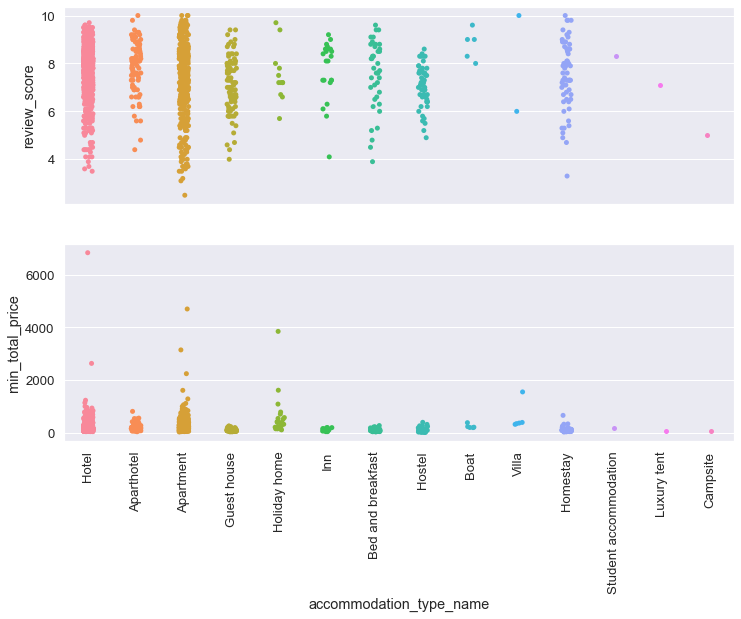

In [34]:
_, axs = plt.subplots(2,1,figsize=(12,8), sharex=True);
sns.stripplot(ax=axs[0], x="accommodation_type_name", y="review_score",
                   data=df3, dodge=True);
axs[0].set(xlabel=None);

sns.stripplot(ax=axs[1], x="accommodation_type_name", y="min_total_price",
                   data=df3, dodge=True);
axs[1].tick_params(axis='x', labelrotation=90);

We observed some patterns from the strip plots, for example:
* There are a few accommodation types (`hotel`, `apartment`, `holiday home`, `villa`) with some extremely high room prices, which are considered as **outliers**, which will be discussed in more detail in the next section.
* There exist more low review scores for the `apartment` than `hotel` type, which might indicate that booking.com should regulate more strictly on apartments to improve the experiences of guests. As a result, it may be beneficial for travellers to exercise more caution when selecting apartments to improve their travel experiences.

### 4.2 Hotel Pricing and Detection of Outliers <a id = '4.2'></a>
In this section, we explore the distribution of hotel prices in London and identify potential outliers in the data. By understanding the overall pricing trends and identifying unusual data points, we can gain a better understanding of the range of prices and the factors that may influence them.

* How is the distribution of hotel prices? Do they follow normal distribution?
* Identification of potential outliers in the data

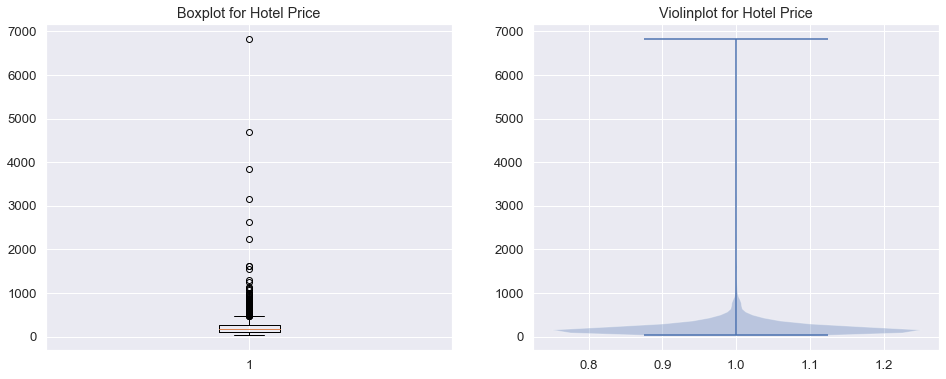

In [35]:
_, (ax1,ax2) = plt.subplots(1,2, figsize = (16,6))
ax1.boxplot(df3['min_total_price']);
ax1.title.set_text('Boxplot for Hotel Price');
ax2.violinplot(df3['min_total_price']);
ax2.title.set_text('Violinplot for Hotel Price');

It is noteworthy that some of those data points deviate significantly from the rest of the data. We should pay special attention to those outliers before further analysis. For example, in histograms, the x-axis would be messed up, and thus influence the overall quality and reliability of our later analysis.

The [Freedman–Diaconis rule](https://en.wikipedia.org/wiki/Freedman%E2%80%93Diaconis_rule) can be used to select the appropriate number of bins to be used when plotting a histogram. 

In [36]:
# Remove outliers using the IQR approach
q1, q3 = np.percentile(df3['min_total_price'], [25, 75])
min_total_price_adjusted = df3['min_total_price'][df3['min_total_price'].between(q1-1.5*(q3-q1), q3+1.5*(q3-q1))]

# Calculate bin width based on the Freedman–Diaconis rule
q25, q75 = np.percentile(min_total_price_adjusted, [25, 75])
bin_width = 2 * (q75 - q25) * len(min_total_price_adjusted) ** (-1/3)
bins = round((min_total_price_adjusted.max() - min_total_price_adjusted.min()) / bin_width)
print("Freedman–Diaconis number of bins:", bins)

Freedman–Diaconis number of bins: 22


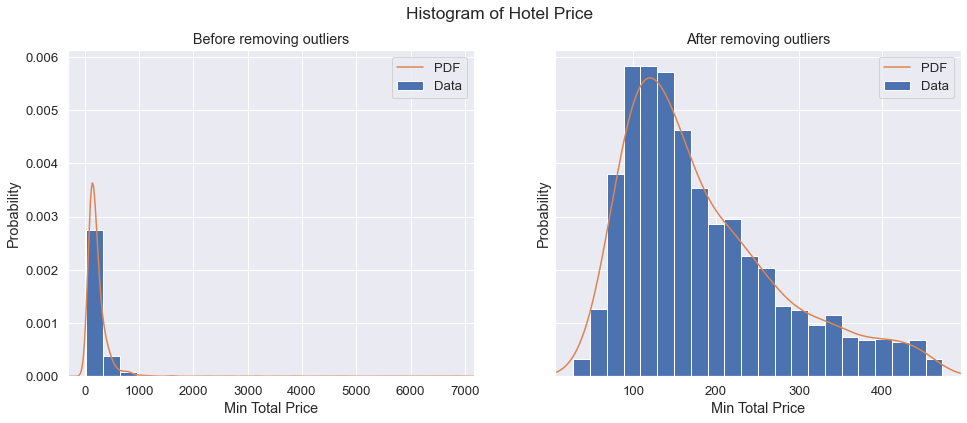

In [37]:
from scipy import stats
fig, axs = plt.subplots(1,2,figsize=(16,6), sharey=True);
fig.suptitle('Histogram of Hotel Price')
axs[0].hist(df3.min_total_price, density=True, bins=bins, label="Data")
mn, mx = axs[0].get_xlim()
axs[0].set_xlim(mn, mx)
kde_xs = np.linspace(mn, mx, 400)
kde = stats.gaussian_kde(df3.min_total_price)
axs[0].plot(kde_xs, kde.pdf(kde_xs), label="PDF")
axs[0].legend(loc="upper right")
axs[0].set_xlabel("Min Total Price")
axs[0].set_ylabel("Probability")
axs[0].set_title("Before removing outliers");

axs[1].hist(min_total_price_adjusted, density=True, bins=bins, label="Data")
mn, mx = axs[1].get_xlim()
axs[1].set_xlim(mn, mx)
kde_xs = np.linspace(mn, mx, 400)
kde = stats.gaussian_kde(min_total_price_adjusted)
axs[1].plot(kde_xs, kde.pdf(kde_xs), label="PDF")
axs[1].legend(loc="upper right")
axs[1].set_xlabel("Min Total Price")
axs[1].set_ylabel("Probability")
axs[1].set_title("After removing outliers");

Based on the plots, we can observe that most hotel prices in the region are within the 75-200 range, and they do not follow a normal distribution, as evidenced by the right-skewed histogram. This suggests that a greater number of hotels in the region have prices that are clustered towards the lower end, with only a few hotels charging significantly higher prices. 

In an economic sense, it could be an indication of the presence of luxury hotels that are targeting high-end customers seeking premium experiences, or it could signify limited competition in the region, with only a few hotels dominating the market and charging higher prices.

Sample ouliers: ['Montcalm Royal London House-City of London', 'ME London by Melia', 'Mandarin Oriental Hyde Park, London', 'Rosewood London', 'The Landmark London', 'Nobu Hotel London Portman Square', 'Shangri-La The Shard, London', 'Egerton House']


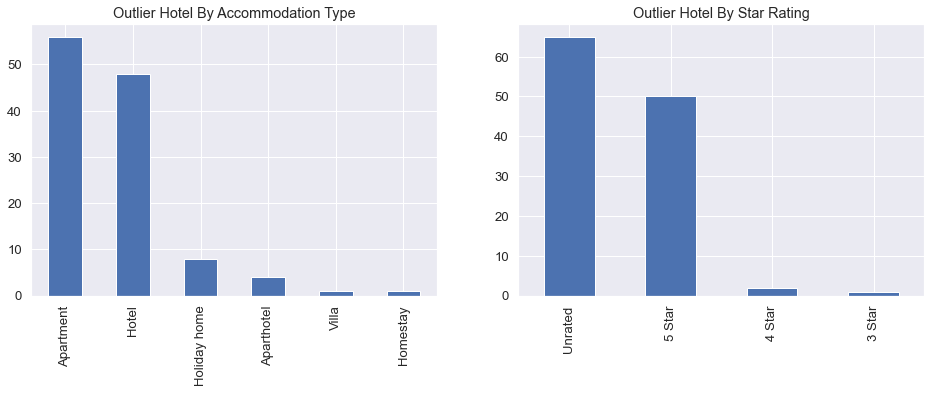

In [38]:
hotel_outliers = df3[~df3['min_total_price'].between(q1-1.5*(q3-q1), q3+1.5*(q3-q1))]

print('Sample ouliers:', hotel_outliers['hotel_name'].to_list()[:8])
fig, ax = plt.subplots(1, 2, figsize = (16,5))

hotel_outliers['accommodation_type_name'].value_counts().plot(kind='bar', ax = ax[0])
ax[0].set_title("Outlier Hotel By Accommodation Type")
hotel_outliers['class'].value_counts().plot(kind='bar', ax = ax[1]);
ax[1].set_xticklabels(['Unrated', '5 Star', '4 Star', '3 Star'])
ax[1].set_title("Outlier Hotel By Star Rating");

A quite large amount of the outliers fall into the property category of `Apartment`. Regaring star rating, the majority of them are unrated and five-star rated properties. Sample outliers include `Mandarin Oriental Hyde Park`, `Shangri-La`,  `Rosewood London`, which are conventionally known as high-end hotels.

### 4.3 Correlation Analysis <a id = '4.3'></a>
By analyzing the correlation map in this section, we can gain insights into the relationships between different features in the dataset. We explore interesting correlations between different features and discuss possible explanations for these relationships. Questions that will be answered here include:

* Correlation map showing the relationship between different features in the dataset
* Discussion of interesting correlations and possible reasons for them Correlation Map(how each feature in the data frame is correlated with each other)

In [39]:
#Form a new dataframe for further analysis, the new dataframe only contains the columns of numeric values
df4=df3[['class','distance_to_cc','review_nr','review_score','is_free_cancellable',
       'is_mobile_deal','mobile_discount_percentage','price_is_final','preferred','hotel_has_vb_boost',
        'preferred_plus','has_free_parking','has_swimming_pool','min_total_price']]
corr=df4.corr()

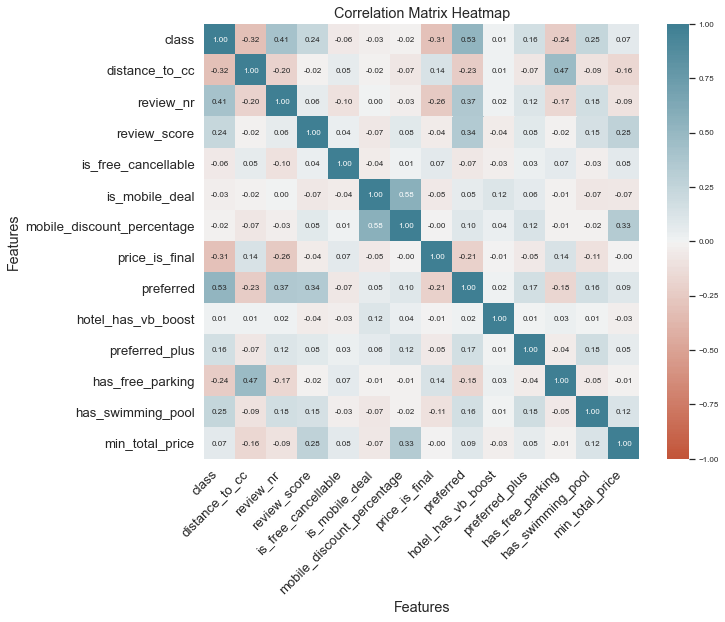

In [40]:
sns.set(font_scale=1.2)
plt.figure(figsize=(10, 8))

sns.heatmap(
    corr,
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200),
    square=True,
    annot=True, fmt='.2f',
    annot_kws={"size": 8},
    cbar_kws={}
)

plt.title('Correlation Matrix Heatmap')
plt.xlabel('Features')
plt.ylabel('Features')

# Customize the x-axis tick labels so it's easier to read
plt.xticks(rotation=45, ha='right')


# Adjust the font size of the colorbar ticks so that the correlation coefficient can fit in the heatmap
cbar = plt.gcf().axes[-1]
cbar.tick_params(labelsize=8)

The correlation heatmap and matrix provide interesting insights that can be grouped into five main points:  
* The **`class`** rating of hotels is **positively** correlated with:  
    * `review_nr` (0.41): Since the class ratings are given by relevant agencies, most of the consumers would feel more secure choosing the hotels with higher class ratings. Thus there will be a larger number of reviews as well.
    * `review_score` (0.43): Hotels with higher class ratings usually have better services and various facilities. Therefore the review score they receive would be higher as well.  
    * `preferred` (0.53) and `preferred_plus` (0.16): Preferred Partner Programme is an exclusive programme that gives greater visibility to the top 30% of partners. The hotels with a higher rating are more likely to meet the set of criteria of the 'top 30% of partners.  
    * `has_swimming_pool` (0.25): Hotels with higher class ratings usually have better services and various facilities. So more likely to have a swimming pool.     
* The **`class`** rating of hotels is **negatively** correlated with:
    * `distance_to_cc` (-0.32): Hotels with higher class ratings usually also have better locations, so it's reasonable that they are closer to the city centre.  
    * `has_free_parking` (-0.24): As mentioned above, hotels with the higher class rating are closer to the city centre. Having free parking would significantly increase the cost in the city centre, so it's less likely for them to have free parking.  
    * `is_private_host` (-0.41): It will be much harder for the private host to have a high class rating, so it's negatively correlated.  
* The **`min_total_price`** is **positively** correlated with:  
    * `mobile_discount_percentage` (0.33): The reason for this may be the psychological pricing strategy of the hotels. By applying a big mobile discount, hotels make consumers think that they could save a lot of money and thus the prices seem much cheaper.  
    * `has_swimming_pool` (0.12): Usually only the hotels with high prices are more likely to have various facilities such as a swimming pool or gym.  
* By comparing the three different packages for partners, we can see from their correlation coefficients with `review_nr` that `Preferred Partner Programme` and `Preferred Plus` are much more efficient than the `Visibility Booster`.  
* `has_swimming_pool` is positively correlated with `review_nr`, `review_score`, `class` and `min_total_price`.  Having or not having a `swimming pool` is an important feature for hotels and consumers. It may be taken as a signal of good hotels.

### 4.4 Geographical Analysis <a id = '4.4'></a>
This section further provides an overview of the spatial distribution of hotel properties in London. We can gain insights into:
* What is the overall geographical distribution like for hotels in London? 
* Is there any significant price differences among different districts?
* If yes, what social, economic or environmental factors could help to explain those differences?

In [41]:
# Initiate the map with the coordinates of London
london_hotel_map = folium.Map(location = [51.509865, -0.118092], 
                              zoom_start = 11, 
                              tiles = 'Stamen Toner')

# Define the color scale of hotel price
min_price = df3["min_total_price"].min()
max_price = df3["min_total_price"].max()

colormap = cm.StepColormap(colors = ['blue','yellow','orange','red'],
                           index = [min_price, 200, 500, 2000, max_price],
                           vmin = min_price,
                           vmax = max_price)

# Plot each hotel in each single iteration
idx = -1

for location, price in zip(zip(df3["latitude"],df3["longitude"]),df3["min_total_price"]):
    idx += 1
    folium.Circle(
        location = location,
        radius = 5,
        fill = True,
        color = colormap(price),
        tooltip = {'Hotel': df3['hotel_name'][idx],
                   'Price': df3['min_total_price'][idx]} 
    ).add_to(london_hotel_map)

london_hotel_map

In this map, the colour represents the price level of a given hotel, with blue being the lowest level and red the highest. 

At a very first glance, some areas in London, such as **Mayfair** and **Knightsbridge** are seen to be concentrated by high-end hotels (The majority of the hotels are labelled as yellow and orange). These high prices may be attributed to their convenient location, exclusive atmosphere, and luxury amenities. For example, these areas are home to designer boutiques, and Michelin-starred restaurants and are located near popular tourist attractions like Buckingham Palace and Hyde Park. 

On the other hand, areas such as **Bayswater** and **Paddington** are generally known to have lower hotel prices (The majority of the hotels are labelled as blue). This may primarily be because they are located slightly away from the city centre and major tourist attractions.

In [42]:
hotel_by_district = pd.pivot_table(df3, index = ['district'],
               values = ['min_total_price', 'hotel_name'], 
               aggfunc = {'min_total_price': np.mean, 'hotel_name':'count'})

# Organize the pivot data
hotel_by_district['Borough'] = hotel_by_district.index
hotel_by_district.reset_index(drop = True, inplace = True)
first_column = hotel_by_district.pop('Borough')
hotel_by_district.insert(0, 'Borough', first_column)

# Sort the data by average prices and count, respectively
display(hotel_by_district.sort_values(by = 'hotel_name', ascending = False).head(3))
display(hotel_by_district.sort_values(by = 'min_total_price', ascending = False).head(3))

,Borough,hotel_name,min_total_price
30,Westminster,489,285.339513
5,Camden,194,220.897732
19,Kensington and Chelsea,164,229.944787


,Borough,hotel_name,min_total_price
29,Wandsworth,64,309.786758
2,Bexley,1,304.000000
30,Westminster,489,285.339513


The districts with the **Top 3** number of hotels are: `Westminster`, `Camden` and `Kensington and Chelsea	`.<br>
The districts with the **Top 3** greatest average prices are: `Wandsworth`, `Bexley` and `Westminster`.

Noticing that in `Bexley`, there is only one hotel, which is not representative, therefore, here we use histgrams and boxplots to give a more detailed and illustrative analysis of hotel pricing by district.

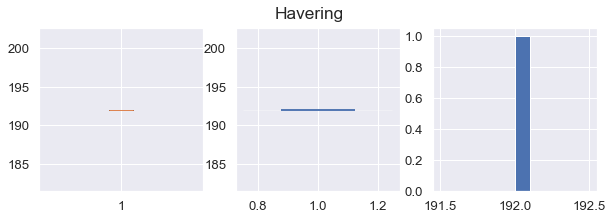

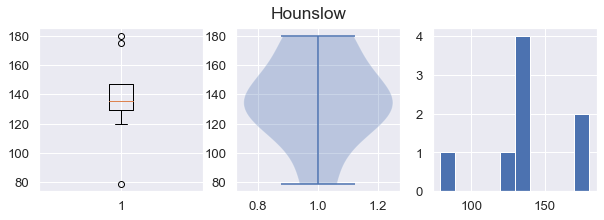

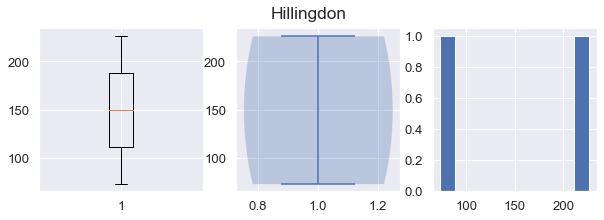

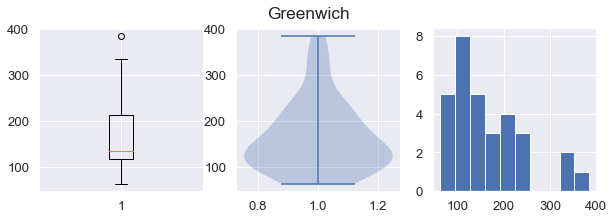

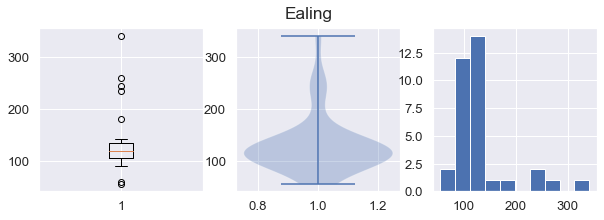

...

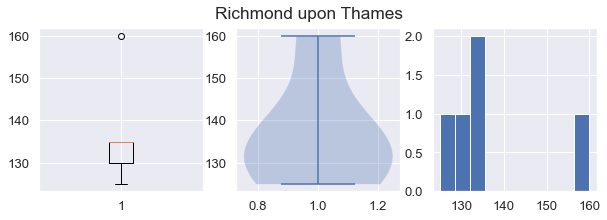

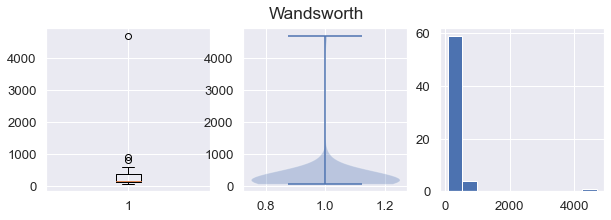

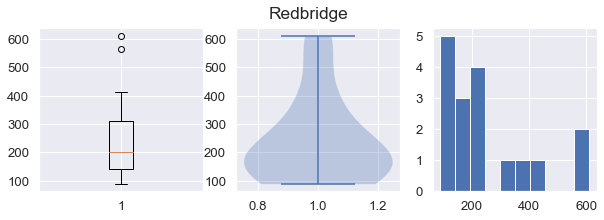

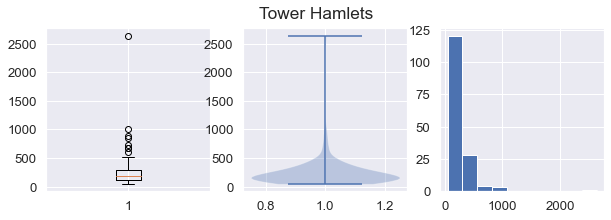

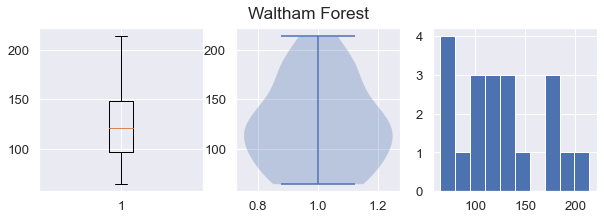

In [43]:
for index, value in enumerate(set(df3['district'])):
    fig, ax = plt.subplots(1, 3, figsize = (10, 3))
    ax[0].boxplot(df3['min_total_price'][df3['district'] == value])
    ax[1].violinplot(df3['min_total_price'][df3['district'] == value])
    ax[2].hist(df3['min_total_price'][df3['district'] == value])
    plt.suptitle(value)

Next, to be more precise in our analysis, we import some socio and economic factors by different district to see how those influence hotel price and distribution.

In [44]:
# Import those separate files
for file in glob.glob('data/London Area Profiles/*.txt'):
    f = pd.read_csv(file, sep = ';')
    hotel_by_district = hotel_by_district.merge(f, how = 'right', on = 'Borough')
    
# Data Cleaning
for col in hotel_by_district.columns:
    if hotel_by_district[col].dtype == 'int64':
        hotel_by_district[col] = hotel_by_district[col].astype('float64')
        
hotel_by_district = hotel_by_district.rename(columns={'hotel_name': 'hotel_count'})
hotel_by_district = hotel_by_district.rename(columns={'Borough': 'district'})
hotel_by_district = hotel_by_district.rename(columns={'min_total_price': 'avg_hotel_price'})

hotel_by_district.head(3)

,district,hotel_count,avg_hotel_price,population_density,tspt_access,house_price,greenspace,crime_rate,population,avg_pay
0,City of London,41.0,269.461951,26.5,90.8,835000.0,4.8,732.69,7681.0,75981.0
1,Barking and Dagenham,2.0,141.680000,58.9,5.6,304995.0,33.6,89.76,212773.0,26296.0
2,Barnet,32.0,188.553750,45.8,5.5,510000.0,41.3,69.41,397049.0,28059.0


In [45]:
# Load Georaphical Dataset
geo = json.load(open('data/london_boroughs.json', encoding="utf8"))

# Initiate the map with the coordinates of London
london_hotel_map = folium.Map(location = [51.509865, -0.118092], 
                              zoom_start = 10, 
                              tiles = 'Cartodbdark_matter')

# capturing the return of folium.Choropleth()
cp = folium.Choropleth(
      geo_data = geo,
      name = "choropleth",
      data = hotel_by_district,
      columns = ["district", 'avg_hotel_price'],
      key_on = "feature.properties.name",
      fill_color = "Blues",
      fill_opacity = 0.6,
      line_opacity = 0.3,
      legend_name = "London Hotel Average Price Level By District",
  ).add_to(london_hotel_map)

district_data_indexed = hotel_by_district.set_index('district')

for s in cp.geojson.data['features']:
    for column in district_data_indexed.columns:
        s['properties'][column] = district_data_indexed.loc[s['properties']['name'], column]


folium.GeoJsonTooltip(list(geo['features'][0]['properties'].keys())).add_to(cp.geojson)

london_hotel_map

Some of the explanations of the description by district, when you hover over the map:

| Feature | Comment |
| --- | --- |
|`inner_statistical` | `true` indicates that the corresponding borough is an "Inner London".
|`greenspace` |% of area that is Greenspace
|`population_density`| Population per hectare 
|`tspt_access`|Average Public Transport Accessibility Score
|`house_price`|Median price paid for all house types
|`crime_rate` |All Crime Rate
|`population` |Total Population
|`avg_pay`|Mean Annual pay

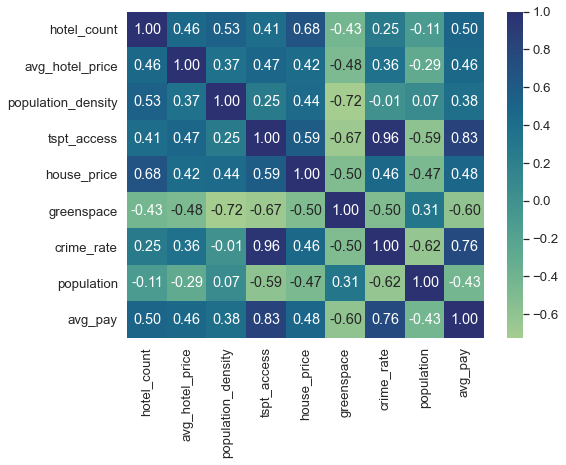

In [46]:
fig = plt.figure(figsize = (8, 6))
sns.heatmap(hotel_by_district.corr(), annot = True, fmt=".2f", cmap = 'crest');

Some interesting clues could be found in this correlation heatmap, for example:
* The total number of hotels is positively correlated with **house price** and **population density** in a certain district (with a correlation of 0.68 and 0.53 respectively), which may suggest that the higher the price level of properties and the dense of population, the more hotels distributed.
* The average hotel price is positively correlated with **transport accessibility** (with a correlation 0.47), as expected.
* The average hotel price is negatively correlated with **greenspace** (with correlation -0.48). This is because, the more rural areas, the more greenspace and hotel price is typically lower.

### 4.5 Affordable and Convenient Location Properties <a id = '4.5'></a>
This section identifies hotels that offer the best value for money based on their location, review score, and price. By focusing on properties that are both affordable and conveniently located, we can help travellers find the best possible options for their stay in London.

* Identification of hotels with a convenient location and decent review scores, but with relatively affordable prices
* Discussion of factors that contribute to the affordability of such properties

`review_score_word` is a column containing some description words based on the guests' review scores: 

| `review_score_word` | `review_score` |
| --- | --- |
|Exceptional|9.5+|
|Superb|9+|
|Fabulous|8.5+|
|Very good|8+|
|Good|7+|
|Pleasant|6+|
|Passable|5+|
|Disappointing|4+|
|Poor|3+|
|Very poor|2+|
|Bad|1+|

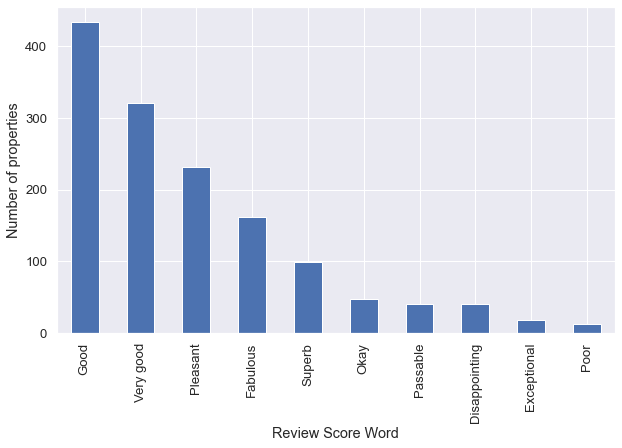

In [47]:
plt.figure(figsize=(10, 6));
df3.loc[df3.review_nr>=10,:].review_score_word.value_counts().plot(kind='bar');
plt.xlabel('Review Score Word');
plt.ylabel('Number of properties');

*Since they are based on the average review scores given by guests, we will only look at those with at least 10 reviews (df3.`review_nr`>=10) to reduce bias*

We created **interactive visualisation** using `plotly.py`, which is an interactive graphing library for Python. [(Plotly, n.d.)](#r6)

In [48]:
# Create interactive plots using Plotly
import plotly.express as px

# The classic Jupyter Notebook sometimes suffers from a problem whereby if you close the window and reopen it, your plots render as blank spaces.
# If this problem is recurrent, try:
#import plotly.io as pio
#pio.renderers.default='notebook'

Outliers would greatly affect the visualisation. Here is the scatter plot including the outliers:

In [49]:
fig = px.scatter(df3.loc[df3.review_nr>=10,:], x='distance_to_cc', y='min_total_price', color='review_score', 
                color_continuous_scale=["red", "green", "blue"], 
                 hover_data=['hotel_name', 'review_score_word', 'review_nr', 'class', 'accommodation_type_name'])

fig.update_layout(title = "Outliers affecting the visualisation")

fig.show("notebook")

If we do not show the outliers, the scatter plot would be more clear:

In [50]:
# Do not display outliers:
q1, q3 = np.nanpercentile(df3['distance_to_cc'], [25, 75])
distance_to_cc_adjusted = df3['distance_to_cc'][df3['distance_to_cc'].between(q1-1.5*(q3-q1), q3+1.5*(q3-q1))]

q1, q3 = np.percentile(df3['min_total_price'], [25, 75])
min_total_price_adjusted = df3['min_total_price'][df3['min_total_price'].between(q1-1.5*(q3-q1), q3+1.5*(q3-q1))]

fig = px.scatter(df3.loc[df3.review_nr>=10,:], x='distance_to_cc', y='min_total_price', color='review_score', 
                color_continuous_scale=["red", "green", "blue"],
                 hover_data=['hotel_name', 'review_score_word', 'review_nr', 'class', 'accommodation_type_name'])

fig.update_layout(xaxis_range=[distance_to_cc_adjusted.min(), distance_to_cc_adjusted.max()], 
                  yaxis_range=[min_total_price_adjusted.min(), min_total_price_adjusted.max()],
                 title = "Not displaying outliers")
fig.show("notebook")

From the interactive scatter plot above, we could see that:
* Generally, the closer to the city centre, the higher the minimum price of stays, also the higher the review scores.
* Surprisingly, there are still some accommodations on the lower end of minimum prices that are close to the city centre, with decent review scores.
    * By moving the mouse cursor over the data points, we could retrieve more information. Looking at the bottom left corner of the plot, we could identify those hotels with convenient locations and decent review scores, but with relatively affordable prices. (e.g. **The Z Hotel Strand**, **NOX Waterloo**, etc).

### 4.6 Hotel Review Analysis <a id = '4.6'></a>

In this section, we would analyse the hotel review data, which includes positive review analysis and negative review analysis. For each part, we mainly generated a word cloud and performed topic modelling using **Latent Dirichlet Allocation (LDA)** [(Kapadia, 2019)](#r5). 

The hotel review data included 10000 rows of reviews from 400 hotels (25 rows of reviews per hotel). The 400 hotels were selected by the ranking of the number of reviews(`review_nr`), which ensured that each hotel had at least 25 reviews for us to retrieve.

The code below shows how we generated the `hotel_ids_for_reviews.json` file. This file includes a `hotel_id` list of the 400 hotels we mentioned above. It was used to retrieve hotel review data through API. (`hotel_id` is a parameter in an API call) 

In [51]:
#Generate hotel_ids_for_reviews.json:
#hotel_ids_for_reviews = df3.sort_values(by='review_nr', ascending=False)['hotel_id'].head(400).to_list()

#import json

# write it into a json file:
#with open("hotel_ids_for_reviews.json", "w") as f:
#    json.dump(hotel_ids_for_reviews, f)

#### Review Data Cleaning

In this subsection, we would perform review data cleaning. We only kept the useful columns (e.g. `pros`, `cons`), and then defined some functions for text processing.

In [52]:
#Read review_data.json and put it into a dataframe
review_df = pd.read_json('data/review_data.json')

Firstly, we remove redundent columns that would not be useful for our text data analysis.

In [53]:
reviews = review_df[['hotel_id', 'review_id', 'pros', 'cons']]
reviews.head()

,hotel_id,review_id,pros,cons
0,180016,3757507039,location was great. Beds were comfortable.,should be more clean for that hotel level. I c...
1,180016,4614133471,"Great room set up for families, double sofa be...",Expensive breakfast
2,180016,2136532421,The location and the rooms are beautiful . The...,"Breakfast could be a bit better I think, no re..."
3,180016,3559451818,location is fantastic. easily accessible by bo...,possibly could have benefitted from more UL pl...
4,180016,3608228339,everything,not enough staff at check-in and had to wait o...


In [54]:
import gensim
from gensim.utils import simple_preprocess
import nltk
#nltk.download('stopwords')
from nltk.corpus import stopwords
#nltk.download('wordnet')
import spacy

Then, we need to pre-process the texts, which mainly includes
* Tokenization, lowercasing, filtering (using Gensim) [(Gensim Tutorial, n.d.)](#r3)
    * Splitting texts into individual words based on whitespace, punctuation, and other separators
    * All tokens are converted to lowercase, which ensures words with different capitalization are treated as equivalent.
    * Tokens that are too short or too long are removed
* Removing stopwords (using NLTK and Gensim) [(GeeksforGeeks, 2023)](#r2) and [(Gensim Tutorial, n.d.)](#r3)
* Lemmatization (Here I used spaCy, which is a modern and efficient library for advanced Natural Language Processing in Python.) [(spaCy, n.d.)](#r7) 

In [55]:
#Tokenization, lowercasing, filtering: tlf(text)
def tlf(text):
    return gensim.utils.simple_preprocess(text)

def remove_stopwords(tokens):
    stop_words = stopwords.words('english')
    stop_words2 = gensim.parsing.preprocessing.STOPWORDS
    return [token for token in tokens if token not in stop_words and token not in stop_words2]

def lemmatize(tokens):
    # Do this at first: python3 -m spacy download en
    nlp = spacy.load('en', disable=['parser', 'ner'])
    # Create a spaCy Doc object
    doc = nlp(' '.join(tokens)) #Here tokens should be a list of words
    lemmas = [token.lemma_ if token.pos_ in ['ADJ', 'VERB', 'NOUN', 'ADV'] else token.text for token in doc]
    return lemmas

#### Positive Review Analysis

In this subsection, we targeted at positive reviews.

In [56]:
# Implement the functions we defined for text processing:

reviews['pros_processed'] = reviews['pros'].map(lambda x: tlf(x))
reviews['pros_processed'] = reviews['pros_processed'].map(lambda x: remove_stopwords(x))
# This line is a bit time-consuming
reviews['pros_processed'] = reviews['pros_processed'].map(lambda x: lemmatize(x))
# Remove stopwords once more to improve accuracy
reviews['pros_processed'] = reviews['pros_processed'].map(lambda x: remove_stopwords(x))

##### Word Cloud

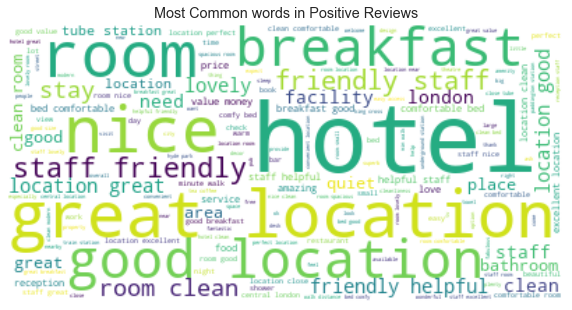

In [57]:
# Import the wordcloud library
from wordcloud import WordCloud
# Join the different processed reviews together.
long_string = ' '.join([' '.join(i) for i in reviews['pros_processed']])
# Create a WordCloud object
wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue')
# Generate a word cloud
wordcloud.generate(long_string)
# Visualize the word cloud
plt.figure(figsize=(10, 6));
plt.imshow(wordcloud, interpolation='bilinear');
plt.axis('off');
plt.title('Most Common words in Positive Reviews');
plt.show();

Based on the word cloud and the nature of the data, we could extend our stopwords list to further remove unnecessary words for further analysis. In our positive review data, words like 'great', 'good' and 'nice' are not useful for topic modelling, and may affect the accuracy of the model, so we decided to treat them as stopwords to remove them.

In [58]:
my_stopwords = ['great', 'good', 'nice']
reviews['pros_processed'] = reviews['pros_processed'].map(lambda x: [token for token in x if token not in my_stopwords])


##### Topic Modelling - LDA

In [59]:
dictionary = gensim.corpora.Dictionary(reviews['pros_processed'])

Have a look at the dictionary (Only showing the first 10) we generated:

In [60]:
c = 0
for k, v in dictionary.iteritems():
    print(k, v)
    c += 1
    if c > 10:
        break

0 bed
1 comfortable
2 location
3 area
4 bathroom
5 bedroom
6 double
7 excellent
8 family
9 helpful
10 lounge


In [61]:
# Remove very rare and very common words:
# - Remove words appearing less than 10 times
# - Remove words appearing in more than 20% of all documents
dictionary.filter_extremes(no_below=10, no_above=0.2)

In [62]:
bow_corpus = [dictionary.doc2bow(doc) for doc in reviews['pros_processed']]

Here is a Bag-of-words example. We randomly picked a review for demonstration.

In [63]:
# BOW Preview (An example)
document_num = 445
bow_doc_x = bow_corpus[document_num]

for i in range(len(bow_doc_x)):
    print(f"Word {bow_doc_x[i][0]} ('{dictionary[bow_doc_x[i][0]]}') appears {bow_doc_x[i][1]} time.")

Word 2 ('area') appears 1 time.
Word 19 ('time') appears 1 time.
Word 29 ('friendly') appears 1 time.
Word 60 ('bar') appears 1 time.
Word 80 ('check') appears 2 time.
Word 148 ('reception') appears 1 time.
Word 154 ('meet') appears 1 time.
Word 239 ('little') appears 1 time.
Word 509 ('colleague') appears 1 time.
Word 510 ('mean') appears 1 time.
Word 511 ('meeting') appears 1 time.


In [64]:
# Train the LDA model:
lda_model =  gensim.models.LdaMulticore(bow_corpus, 
                                        num_topics = 4, 
                                        id2word = dictionary, 
                                        random_state=445445,
                                        passes = 50)

In [65]:
for idx, topic in lda_model.print_topics(-1):
    print(f"Topic: {idx} \nWords: {topic}")
    print("\n")

Topic: 0 
Words: 0.087*"friendly" + 0.065*"helpful" + 0.036*"lovely" + 0.034*"comfortable" + 0.027*"value" + 0.025*"hotel" + 0.025*"bed" + 0.022*"reception" + 0.020*"money" + 0.015*"stay"


Topic: 1 
Words: 0.080*"breakfast" + 0.036*"hotel" + 0.026*"excellent" + 0.024*"check" + 0.022*"stay" + 0.022*"facility" + 0.020*"service" + 0.018*"friendly" + 0.018*"amazing" + 0.017*"lovely"


Topic: 2 
Words: 0.059*"station" + 0.049*"close" + 0.035*"walk" + 0.032*"tube" + 0.030*"hotel" + 0.024*"london" + 0.020*"near" + 0.018*"minute" + 0.017*"easy" + 0.017*"underground"


Topic: 3 
Words: 0.069*"bed" + 0.060*"comfortable" + 0.033*"price" + 0.031*"bathroom" + 0.028*"quiet" + 0.028*"spacious" + 0.021*"comfy" + 0.019*"london" + 0.018*"hotel" + 0.018*"central"




In [66]:
from collections import Counter
topics = lda_model.show_topics(formatted=False)
data_flat = [w for w_list in reviews['pros_processed'] for w in w_list]
counter = Counter(data_flat)

out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])

df_plot = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count']) 
df_plot

,word,topic_id,importance,word_count
0,friendly,0,0.087368,1842
1,helpful,0,0.064990,1246
2,lovely,0,0.036266,834
3,comfortable,0,0.034235,1269
4,value,0,0.026833,368
5,hotel,0,0.025431,1738
6,bed,0,0.025355,1182
7,reception,0,0.022064,409
8,money,0,0.020273,278
9,stay,0,0.015098,919


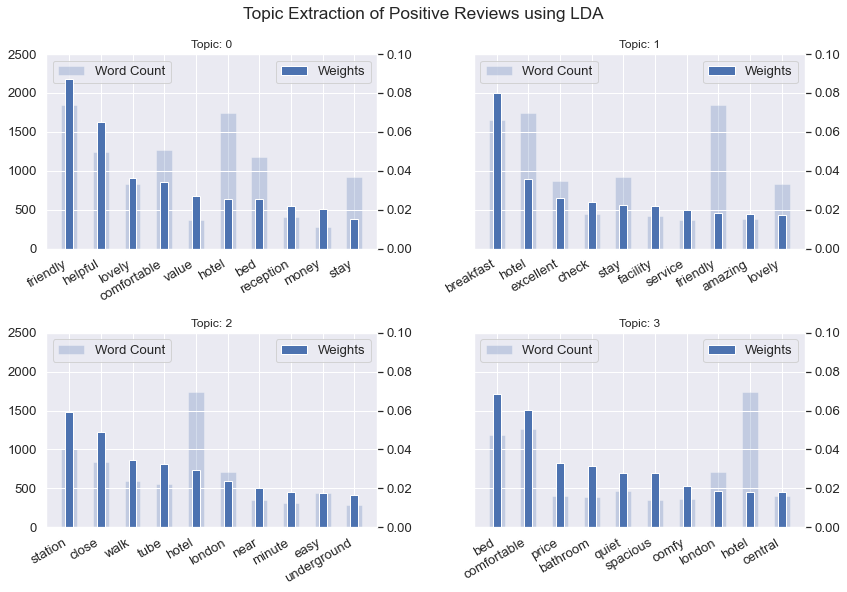

In [82]:
fig, axes = plt.subplots(2, 2, figsize=(12,8), sharey=True)
for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="word_count", data=df_plot.loc[df_plot.topic_id==i, :], width=0.5, alpha=0.25, label='Word Count')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df_plot.loc[df_plot.topic_id==i, :], width=0.25, label='Weights')
    ax_twin.set_ylim(0, 0.100); ax.set_ylim(0, 2500)
    #ax.set_ylabel('Word Count')
    ax.set_title('Topic: ' + str(i), fontsize=12)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(df_plot.loc[df_plot.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')
    
fig.tight_layout(w_pad=2) 
fig.suptitle('Topic Extraction of Positive Reviews using LDA', y=1.03);

Examining the top 10 words in each topic for positive reviews, we can conclude from the bar plots that:
* For topic 0 and topic 2, the extracted topics seem more clear then the others. In topic 0, the top 2 words (by weights) are `friendly` and `helpful`, which indicated that guests appreciated the service provided by hotel staff. In topic 2, it is clear that hotels' convenient locations (e.g. `close` to `station`/`tube`, 10-minute `walk` to...) are crucial for guests' experiences.
* For topic 3, it is more about the room (`bed`, `bathroom`, `spacious`), but they are not well separated. There is no clear pattern for topic 1 as well.

##### t-SNE

In [68]:
import numpy as np
# Get the topic distribution for each review(document)
doc_topic_dist = np.array([lda_model.get_document_topics(doc, minimum_probability=0) for doc in bow_corpus])
doc_topic_matrix = doc_topic_dist[:, :, 1] 

In [69]:
# Use t-SNE to reduce the dimensionality
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, random_state=445)
doc_topic_tsne = tsne.fit_transform(doc_topic_matrix)

In [70]:
# Create a dataframe with the t-SNE embeddings and the most probable topic for each review
topic_labels = [f'Topic {i}' for i in range(lda_model.num_topics)]
df_tsne = pd.DataFrame({
    'x': doc_topic_tsne[:, 0],
    'y': doc_topic_tsne[:, 1],
    'Most Probable Topic': np.argmax(doc_topic_matrix, axis=1),
    'Topic Labels': [topic_labels[i] for i in np.argmax(doc_topic_matrix, axis=1)],
    'Positive Review Content': reviews['pros']
})
df_tsne

,x,y,Most Probable Topic,Topic Labels,Positive Review Content
0,-58.277523,-1.364122,3,Topic 3,location was great. Beds were comfortable.
1,-13.896159,20.828989,3,Topic 3,"Great room set up for families, double sofa be..."
2,60.885704,-50.482315,1,Topic 1,The location and the rooms are beautiful . The...
3,-57.175617,63.173061,2,Topic 2,location is fantastic. easily accessible by bo...
4,-8.632151,-4.521257,0,Topic 0,everything
...,...,...,...,...,...
9995,31.925457,-1.245939,1,Topic 1,"A lovely hotel, perfect location, central yet ..."
9996,-11.609337,-4.813485,0,Topic 0,"Staff, location"
9997,26.006489,-7.786886,3,Topic 3,If you've ever stayed in a Bloomsbury townhous...
9998,-0.807658,-72.646210,0,Topic 0,Super friendly staff. Great location. Nice and...


In [71]:
# Create an interactive scatter plot using Plotly
fig = px.scatter(df_tsne, x='x', y='y', 
                 color='Topic Labels', 
                 hover_data=['Most Probable Topic', 'Positive Review Content'], 
                 title='t-SNE Clustering for Visualisation of LDA Result (Positive Reviews)')
fig.show("notebook")

The plot above shows the LDA result using t-SNE clustering, which is a popular statistical method for visualising high-dimensional data. By hovering over the data points, original positive reviews can be seen. Different colors represent different topics extracted from the LDA model.

As we can see from the t-SNE plot, the data points are not separated very well, since the underlying patterns in the data are complex and subtle.

#### Negative Review Analysis

Next, we followed the similar procedure as above to analyse negative reviews.

In [83]:
# Implement the functions we defined for text processing:

reviews['cons_processed'] = reviews['cons'].map(lambda x: tlf(x))
reviews['cons_processed'] = reviews['cons_processed'].map(lambda x: remove_stopwords(x))
# This line is a bit time-consuming
reviews['cons_processed'] = reviews['cons_processed'].map(lambda x: lemmatize(x))
# Remove stopwords once more to improve accuracy
reviews['cons_processed'] = reviews['cons_processed'].map(lambda x: remove_stopwords(x))

##### Word Cloud

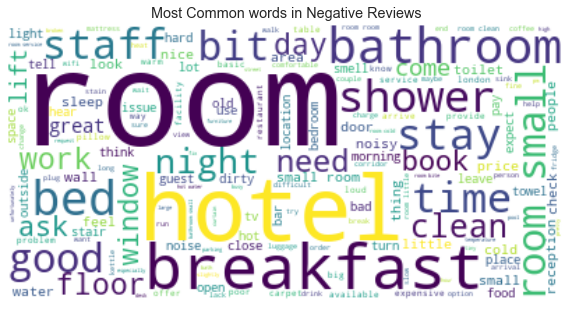

In [84]:
# Import the wordcloud library
from wordcloud import WordCloud
# Join the different processed reviews together.
long_string = ' '.join([' '.join(i) for i in reviews['cons_processed']])
# Create a WordCloud object
wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue')
# Generate a word cloud
wordcloud.generate(long_string)
# Visualize the word cloud
plt.figure(figsize=(10, 6));
plt.imshow(wordcloud, interpolation='bilinear');
plt.axis('off');
plt.title('Most Common words in Negative Reviews');
plt.show();

From the word cloud, we can think of some complaint about `small room` and `breakfast`. Next, we will try to extract some topics related to these issues. 

##### Topic Modelling - LDA

In [85]:
dictionary = gensim.corpora.Dictionary(reviews['cons_processed'])
dictionary.filter_extremes(no_below=5, no_above=0.2)
bow_corpus = [dictionary.doc2bow(doc) for doc in reviews['cons_processed']]

In [86]:
lda_model2 =  gensim.models.LdaMulticore(bow_corpus, 
                                        num_topics = 4, 
                                        id2word = dictionary, 
                                        random_state=445,
                                        passes = 50)

In [87]:
for idx, topic in lda_model2.print_topics(-1):
    print(f"Topic: {idx} \nWords: {topic}")
    print("\n")

Topic: 0 
Words: 0.034*"hotel" + 0.021*"stay" + 0.019*"window" + 0.019*"book" + 0.018*"night" + 0.016*"like" + 0.014*"noise" + 0.011*"bit" + 0.010*"time" + 0.009*"noisy"


Topic: 1 
Words: 0.037*"shower" + 0.027*"bathroom" + 0.019*"water" + 0.018*"door" + 0.017*"work" + 0.016*"night" + 0.016*"clean" + 0.015*"cold" + 0.015*"hot" + 0.014*"toilet"


Topic: 2 
Words: 0.090*"small" + 0.050*"bed" + 0.026*"bathroom" + 0.024*"little" + 0.021*"bit" + 0.020*"need" + 0.020*"good" + 0.013*"space" + 0.013*"price" + 0.013*"comfortable"


Topic: 3 
Words: 0.042*"breakfast" + 0.029*"staff" + 0.015*"bar" + 0.014*"lift" + 0.013*"hotel" + 0.012*"check" + 0.012*"reception" + 0.011*"service" + 0.011*"time" + 0.010*"food"




In [88]:
from collections import Counter
topics = lda_model2.show_topics(formatted=False)
data_flat = [w for w_list in reviews['cons_processed'] for w in w_list]
counter = Counter(data_flat)

out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])

df_plot = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count']) 
df_plot

,word,topic_id,importance,word_count
0,hotel,0,0.034262,887
1,stay,0,0.020723,599
2,window,0,0.019160,472
3,book,0,0.018715,322
4,night,0,0.017819,618
5,like,0,0.016098,542
6,noise,0,0.014427,349
7,bit,0,0.010994,667
8,time,0,0.009650,466
9,noisy,0,0.009281,313


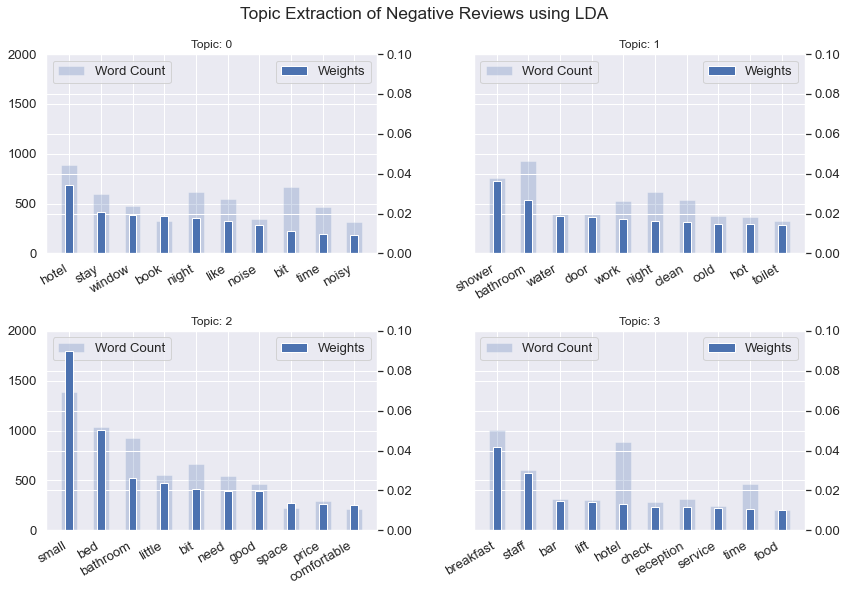

In [89]:
fig, axes = plt.subplots(2, 2, figsize=(12,8), sharey=True)
for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="word_count", data=df_plot.loc[df_plot.topic_id==i, :], width=0.5, alpha=0.25, label='Word Count')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df_plot.loc[df_plot.topic_id==i, :], width=0.25, label='Weights')
    ax_twin.set_ylim(0, 0.100); ax.set_ylim(0, 2000)
    #ax.set_ylabel('Word Count')
    ax.set_title('Topic: ' + str(i), fontsize=12)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(df_plot.loc[df_plot.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')
    
fig.tight_layout(w_pad=2) 
fig.suptitle('Topic Extraction of Negative Reviews using LDA', y=1.03);

Examining the top 10 words in each topic for negative reviews, we can conclude from the bar plots that:
* For topic 0, it is related to the noise. (e.g. `window`, `night`, `noise`)
* For topic 1, it is related to the bathroom. (e.g. `shower`, `bathroom`, `water`, `toilet`)
* For topic 2, it is more related to the room space (e.g. `small`, `space`), but words are not separated very well in terms of topics.
* For topic 3, it is related to the service and breakfast. (e.g. `staff`, `breakfast`, `reception`, `service`)

As expected, these extracted topics are common issues that guests are frequently complaining about. To improve the satisfaction of guests, managers should upgrade their hotels correspondingly.

##### t-SNE

In [90]:
import numpy as np
# Get the topic distribution for each review(document)
doc_topic_dist = np.array([lda_model2.get_document_topics(doc, minimum_probability=0) for doc in bow_corpus])
doc_topic_matrix = doc_topic_dist[:, :, 1] 

In [91]:
# Use t-SNE to reduce the dimensionality
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, random_state=445)
doc_topic_tsne = tsne.fit_transform(doc_topic_matrix)

In [92]:
# Create a dataframe with the t-SNE embeddings and the most probable topic for each review
topic_labels = [f'Topic {i}' for i in range(lda_model2.num_topics)]
df_tsne2 = pd.DataFrame({
    'x': doc_topic_tsne[:, 0],
    'y': doc_topic_tsne[:, 1],
    'Most Probable Topic': np.argmax(doc_topic_matrix, axis=1),
    'Topic Labels': [topic_labels[i] for i in np.argmax(doc_topic_matrix, axis=1)],
    'Negative Review Content': reviews['cons']
})
df_tsne2

,x,y,Most Probable Topic,Topic Labels,Negative Review Content
0,37.497177,28.377552,3,Topic 3,should be more clean for that hotel level. I c...
1,64.694206,3.778971,3,Topic 3,Expensive breakfast
2,51.214367,25.208767,3,Topic 3,"Breakfast could be a bit better I think, no re..."
3,-84.418106,16.487972,2,Topic 2,possibly could have benefitted from more UL pl...
4,83.680519,-31.503487,3,Topic 3,not enough staff at check-in and had to wait o...
...,...,...,...,...,...
9995,-36.615738,23.016766,3,Topic 3,it was a bit too hot in the rooms.\r\nregardin...
9996,1.972863,-79.052765,2,Topic 2,Bed was surely too short:)\nMediocre continent...
9997,-82.661362,-12.997360,2,Topic 2,"It's not cheap, but nothing in London is :)"
9998,-54.783154,-80.383751,2,Topic 2,The single room is a bit small but is just abo...


In [93]:
# Create an interactive scatter plot using Plotly
fig = px.scatter(df_tsne2, x='x', y='y', 
                 color='Topic Labels', 
                 hover_data=['Most Probable Topic', 'Negative Review Content'], 
                 title='t-SNE Clustering for Visualisation of LDA Result (Negative Reviews)')
fig.show("notebook")

Similarly, the plot above shows the LDA result for negative reviews using t-SNE. It seems that it is better than the one for positive reviews in terms of overlapping between different topics.

The limitation of this subsection is that the number of reviews we got is not large enough, due to the limited calls of API, and the computational complexity when performing lemmatization. Another limitation is the nature of the hotel review data. Each comment often contains multiple elements/topics, which causes data points in the t-SNE plot not to be very well separated. In addition, some reviews were too short, and some pros were even miswritten into cons or vice versa. Hence the accuracy of our analysis had a bottleneck. We may increase our number of reviews, and improve the data quality in the future for improvement.

### 4.7 Machine Learning Models for Hotel Price Prediction <a id = '4.7'></a>

The last section of this report focuses on using machine learning models to predict hotel room prices in London. Models used include: 
* Linear Regression
* Ridge Regression
* Lasso Regression
* Polynomial Regression
* SVM Regression
* XGBoost Regression
* Random Forest Regression

Ultimately, the section aims to provide valuable insights into the effectiveness of these models in predicting hotel prices in London, and the impact of various features on the hotel price.

#### Data Preparation for Modelling Purpose

In [94]:
from sklearn.model_selection import KFold, GridSearchCV, train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import PolynomialFeatures, StandardScaler,OneHotEncoder
from sklearn.svm import SVR
import xgboost as xgb
from sklearn.ensemble import RandomForestRegressor
from sklearn.impute import SimpleImputer

In [95]:
# Drop the non-numerical columns
df5 = df3.drop(columns=['hotel_name', 'hotel_id', 'address', 'zip', 'review_score_word', 
                        'longitude', 'latitude', 'unit_configuration_label', 'room_type'])

# Converting categorical variables into numerical variables
df5['num_room_left'] = df5['num_room_left'].astype(str)
cols = ['accommodation_type_name', 'district', 'num_room_left']
ohe = OneHotEncoder(handle_unknown='ignore', sparse=False)
df6 = pd.DataFrame(ohe.fit_transform(df5[cols]))
df6.columns = ohe.get_feature_names_out(cols)

df_regression = pd.concat([df5, df6], axis=1)
df_regression = df_regression.drop(columns = cols)

# Set up independent variable and dependent variables
y = df_regression.min_total_price
X = df_regression.drop(columns='min_total_price')

# Fill the missing data with the column mean
imp = SimpleImputer(missing_values=np.nan, strategy='mean')
X = imp.fit_transform(X)

#### Model 1: Linear Regression
Linear regression is a popular machine learning algorithm that is used to predict numerical variables based on a set of input features. Here it can provide valuable insights into the key drivers of hotel prices.

In [96]:
# Split the data into 20-fold in order to carry out 20-fold cross validation
num_folds = 20
kf = KFold(n_splits=num_folds, shuffle=True, random_state=445)

In [97]:
# Set up lists to store the metric scores
mae_scores = []
mse_scores = []
rmse_scores = []
mape_scores = []
accuracy_scores = []

# Iterate over each fold
for train_index, test_index in kf.split(X):
    # Get the training and testing sets for the fold
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

    # Fit a linear regression model
    lr = LinearRegression()
    lr.fit(X_train, y_train)
    
    # Make predictions on the test set
    y_pred = lr.predict(X_test)
    
    # Calculate the metric scores for this fold
    mae_scores.append(mean_absolute_error(y_test, y_pred))
    mse_scores.append(mean_squared_error(y_test, y_pred))
    rmse_scores.append(np.sqrt(mean_squared_error(y_test, y_pred)))
    mape_scores.append(mean_absolute_percentage_error(y_test, y_pred))
    accuracy_scores.append(round(100*(1 - mean_absolute_percentage_error(y_test, y_pred)), 2))

MAE_1=np.mean(mae_scores)
MSE_1=np.mean(mse_scores)
RMSE_1=np.mean(rmse_scores)
MAPE_1=np.mean(mape_scores)
Accuracy_1=np.mean(accuracy_scores)

# Print the average scores for each metric over all folds
print("MAE: ", MAE_1)
print("MSE: ", MSE_1)
print("RMSE: ", RMSE_1)
print("MAPE: ", MAPE_1)
print("Accuracy: ", Accuracy_1)

MAE:  98.09654381154442
MSE:  60216.80823270074
RMSE:  204.29172072406328
MAPE:  0.5045555797859976
Accuracy:  49.54449999999999


#### Model 2: Ridge Regression
Ridge regression is a regularized version of linear regression that can help to prevent over-fitting, which can be used to improve the accuracy of the linear regression model by adding a penalty term to the cost function.

In [98]:
# Set up lists to store the metric scores
mae_scores = []
mse_scores = []
rmse_scores = []
mape_scores = []
accuracy_scores = []

# Set up the grid of hyperparameters to search over
param_grid = {'alpha': np.logspace(-3, 3, 20)}

# Iterate over each fold
for train_index, test_index in kf.split(X):
    # Get the training and testing sets for the fold
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

    # Perform a grid search to find the best hyperparameters for this fold
    grid_search = GridSearchCV(Ridge(), param_grid, cv=5)
    grid_search.fit(X_train, y_train)

    # Fit a Ridge regression model with the best hyperparameters for this fold
    ridge = grid_search.best_estimator_
    ridge.fit(X_train, y_train)
    
    # Make predictions on the test set
    y_pred = ridge.predict(X_test)
    
    # Calculate the metric scores for this fold
    mae_scores.append(mean_absolute_error(y_test, y_pred))
    mse_scores.append(mean_squared_error(y_test, y_pred))
    rmse_scores.append(np.sqrt(mean_squared_error(y_test, y_pred)))
    mape_scores.append(mean_absolute_percentage_error(y_test, y_pred))
    accuracy_scores.append(round(100*(1 - mean_absolute_percentage_error(y_test, y_pred)), 2))

MAE_2=np.mean(mae_scores)
MSE_2=np.mean(mse_scores)
RMSE_2=np.mean(rmse_scores)
MAPE_2=np.mean(mape_scores)
Accuracy_2=np.mean(accuracy_scores)

# Print the average scores for each metric over all folds
print("MAE: ", MAE_2)
print("MSE: ", MSE_2)
print("RMSE: ", RMSE_2)
print("MAPE: ", MAPE_2)
print("Accuracy: ", Accuracy_2)

MAE:  94.04386669431099
MSE:  61682.7385704321
RMSE:  205.83589415155038
MAPE:  0.45447082191672655
Accuracy:  54.5535


#### Model 3: Lasso Regression
Lasso regression is another type of regularized linear regression that can help to prevent over-fitting by shrinking the coefficients of the input features towards zero.

In [99]:
# Set up lists to store the metric scores
mae_scores = []
mse_scores = []
rmse_scores = []
mape_scores = []
accuracy_scores = []

# Set up the grid of hyperparameters to search over
param_grid = {'alpha': np.logspace(-3, 3, 20)}

# Iterate over each fold
for train_index, test_index in kf.split(X):
    # Get the training and testing sets for the fold
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

    # Perform a grid search to find the best hyperparameters for this fold
    grid_search = GridSearchCV(Lasso(max_iter=10000), param_grid, cv=10)
    grid_search.fit(X_train, y_train)

    # Fit a Lasso regression model with the best hyperparameters for this fold
    lasso = grid_search.best_estimator_
    lasso.fit(X_train, y_train)
    
    # Make predictions on the test set
    y_pred = lasso.predict(X_test)
    
    # Calculate the metric scores for this fold
    mae_scores.append(mean_absolute_error(y_test, y_pred))
    mse_scores.append(mean_squared_error(y_test, y_pred))
    rmse_scores.append(np.sqrt(mean_squared_error(y_test, y_pred)))
    mape_scores.append(mean_absolute_percentage_error(y_test, y_pred))
    accuracy_scores.append(round(100*(1 - mean_absolute_percentage_error(y_test, y_pred)), 2))

MAE_3=np.mean(mae_scores)
MSE_3=np.mean(mse_scores)
RMSE_3=np.mean(rmse_scores)
MAPE_3=np.mean(mape_scores)
Accuracy_3=np.mean(accuracy_scores)

# Print the average scores for each metric over all folds
print("MAE: ", MAE_3)
print("MSE: ", MSE_3)
print("RMSE: ", RMSE_3)
print("MAPE: ", MAPE_3)
print("Accuracy: ", Accuracy_3)

MAE:  96.06929780833292
MSE:  61736.705203965845
RMSE:  208.09641649913587
MAPE:  0.47207927098258046
Accuracy:  52.7915


#### Model 4: Polynomial Regression
Polynomial regression is a variation of linear regression that allows for nonlinear relationships between the predictors and the outcome. 

When attempting to forecast how the price of a hotel will change as the distance from the city centre (`distance_to_cc`) increases, for instance, it is sometimes the case that hotels closer to the city centre will see price increases that are more rapid, or that the relationship is with a quadratic or cubic term that Linear Regression was unable to capture.

In [100]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=445, test_size=0.25, shuffle=True)

In [101]:
# Set up lists to store the metric scores
mae_scores = []
mse_scores = []
rmse_scores = []
mape_scores = []
accuracy_scores = []

# Set up the grid of hyperparameters to search over
param_grid = {'poly__degree': [1, 2, 3],
              'linear__fit_intercept': [True, False]}


# Set up the pipeline for the polynomial regression model
pipeline = Pipeline([('poly', PolynomialFeatures()),
                         ('linear', LinearRegression())])

# Perform a grid search to find the best hyperparameters for this fold
grid_search = GridSearchCV(pipeline, param_grid, cv=5)
grid_search.fit(X_train, y_train)

# Fit a polynomial regression model with the best hyperparameters for this fold
poly = grid_search.best_estimator_
poly.fit(X_train, y_train)

# Make predictions on the test set
y_pred = poly.predict(X_test)

# Calculate the metric scores for this fold
mae_scores.append(mean_absolute_error(y_test, y_pred))
mse_scores.append(mean_squared_error(y_test, y_pred))
rmse_scores.append(np.sqrt(mean_squared_error(y_test, y_pred)))
mape_scores.append(mean_absolute_percentage_error(y_test, y_pred))
accuracy_scores.append(round(100*(1 - mean_absolute_percentage_error(y_test, y_pred)), 2))

MAE_4 = np.mean(mae_scores)
MSE_4 = np.mean(mse_scores)
RMSE_4 = np.mean(rmse_scores)
MAPE_4 = np.mean(mape_scores)
Accuracy_4 = np.mean(accuracy_scores)

# Print the average scores for each metric over all folds
print("MAE: ", MAE_4)
print("MSE: ", MSE_4)
print("RMSE: ", RMSE_4)
print("MAPE: ", MAPE_4)
print("Accuracy: ", Accuracy_4)
print("Best tuning parameter:", grid_search.best_params_)

MAE:  93.47198587102568
MSE:  27481.18760926063
RMSE:  165.7745083215771
MAPE:  0.5198502876249729
Accuracy:  48.01
Best tuning parameter: {'linear__fit_intercept': False, 'poly__degree': 1}


#### Model 5: SVM (Support Vector Machine) Regression
Being similar to Polynomial Regression, Support Vector Machine (SVM) regression is a type of machine learning model that is particularly useful in cases where there is a nonlinear relationship between the predictors and the outcome.

In [102]:
# Set up lists to store the metric scores
mae_scores = []
mse_scores = []
rmse_scores = []
mape_scores = []
accuracy_scores = []

# Scale the data
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Set up the grid of hyperparameters to search over
param_grid = {
    'C': [0.1, 1, 10],
    'kernel': ['linear', 'poly', 'rbf'],
    'degree': [2, 3, 4],
    'gamma': ['scale', 'auto']
}

# Set up the grid search with 5-fold cross-validation
grid_search = GridSearchCV(SVR(), param_grid, cv=5)

# Fit the SVM regression model with the best hyperparameters for this fold
grid_search.fit(X_train, y_train)
svm = grid_search.best_estimator_
svm.fit(X_train, y_train)

# Make predictions on the test set
y_pred = svm.predict(X_test)

# Calculate the metric scores for this fold
mae_scores.append(mean_absolute_error(y_test, y_pred))
mse_scores.append(mean_squared_error(y_test, y_pred))
rmse_scores.append(np.sqrt(mean_squared_error(y_test, y_pred)))
mape_scores.append(mean_absolute_percentage_error(y_test, y_pred))
accuracy_scores.append(round(100*(1 - mean_absolute_percentage_error(y_test, y_pred)), 2))

MAE_5 = np.mean(mae_scores)
MSE_5 = np.mean(mse_scores)
RMSE_5 = np.mean(rmse_scores)
MAPE_5 = np.mean(mape_scores)
Accuracy_5 = np.mean(accuracy_scores)

# Print the average scores for each metric over all folds
print("MAE: ", MAE_5)
print("MSE: ", MSE_5)
print("RMSE: ", RMSE_5)
print("MAPE: ", MAPE_5)
print("Accuracy: ", Accuracy_5)

MAE:  75.56758741198468
MSE:  28539.783241677276
RMSE:  168.93721686377242
MAPE:  0.3098785915040591
Accuracy:  69.01


#### Model 6: XGBoost Regression
XGBoost, which is short for Extreme Gradient Boosting, is a powerful boosting algorithm. It works by building an ensemble of decision trees that are trained on different subsets of the data, with a relatively low bias.

In [103]:
# Set up lists to store the metric scores
mae_scores = []
mse_scores = []
rmse_scores = []
mape_scores = []
accuracy_scores = []

# Set up the XGBoost model
xgb_model = xgb.XGBRegressor(random_state=42)

# Set up the grid of hyperparameters to search over
param_grid = {
    'n_estimators': [50, 100, 150],
    'max_depth': [ 5,6, 7],
    'learning_rate': [0.25, 0.3,0.35]
}

# Set up the grid search with 5-fold cross-validation
grid_search = GridSearchCV(xgb_model, param_grid, cv=5)

# Fit the XGBoost model with the best hyperparameters for this fold
grid_search.fit(X_train, y_train)
xgb = grid_search.best_estimator_
xgb.fit(X_train, y_train)

# Make predictions on the test set
y_pred = xgb.predict(X_test)

# Calculate the metric scores for this fold
mae_scores.append(mean_absolute_error(y_test, y_pred))
mse_scores.append(mean_squared_error(y_test, y_pred))
rmse_scores.append(np.sqrt(mean_squared_error(y_test, y_pred)))
mape_scores.append(mean_absolute_percentage_error(y_test, y_pred))
accuracy_scores.append(round(100*(1 - mean_absolute_percentage_error(y_test, y_pred)), 2))

MAE_6 = np.mean(mae_scores)
MSE_6 = np.mean(mse_scores)
RMSE_6 = np.mean(rmse_scores)
MAPE_6 = np.mean(mape_scores)
Accuracy_6 = np.mean(accuracy_scores)

# Print the average scores for each metric over all folds
print("MAE: ", MAE_6)
print("MSE: ", MSE_6)
print("RMSE: ", RMSE_6)
print("MAPE: ", MAPE_6)
print("Accuracy: ", Accuracy_6)

MAE:  65.68957490030924
MSE:  26302.385229626914
RMSE:  162.1801012135179
MAPE:  0.2957067878307395
Accuracy:  70.43


#### Model 7: Random Forest Regression
Random Forest is another ensemble method that works by building a large number of decision trees and combining their predictions to produce a final outcome.

In [104]:
# Set up lists to store the metric scores
mae_scores = []
mse_scores = []
rmse_scores = []
mape_scores = []
accuracy_scores = []

# Set up the Random Forest Regressor model
rf_model = RandomForestRegressor(random_state=42)

# Set up the grid of hyperparameters to search over
param_grid = {
    'n_estimators': [50, 100, 200],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Set up the grid search with 5-fold cross-validation
grid_search = GridSearchCV(rf_model, param_grid, cv=5)

# Fit the Random Forest Regressor model with the best hyperparameters for this fold
grid_search.fit(X_train, y_train)
rf = grid_search.best_estimator_
rf.fit(X_train, y_train)

# Make predictions on the test set
y_pred = rf.predict(X_test)

# Calculate the metric scores for this fold
mae_scores.append(mean_absolute_error(y_test, y_pred))
mse_scores.append(mean_squared_error(y_test, y_pred))
rmse_scores.append(np.sqrt(mean_squared_error(y_test, y_pred)))
mape_scores.append(mean_absolute_percentage_error(y_test, y_pred))
accuracy_scores.append(round(100*(1 - mean_absolute_percentage_error(y_test, y_pred)), 2))

MAE_7 = np.mean(mae_scores)
MSE_7 = np.mean(mse_scores)
RMSE_7 = np.mean(rmse_scores)
MAPE_7 = np.mean(mape_scores)
Accuracy_7 = np.mean(accuracy_scores)

# Print the average scores for each metric over all folds
print("MAE: ", MAE_7)
print("MSE: ", MSE_7)
print("RMSE: ", RMSE_7)
print("MAPE: ", MAPE_7)
print("Accuracy: ", Accuracy_7)

MAE:  66.24242168643143
MSE:  23332.585768714638
RMSE:  152.75007616598637
MAPE:  0.2938818751905323
Accuracy:  70.61


#### Evaluation Metrics

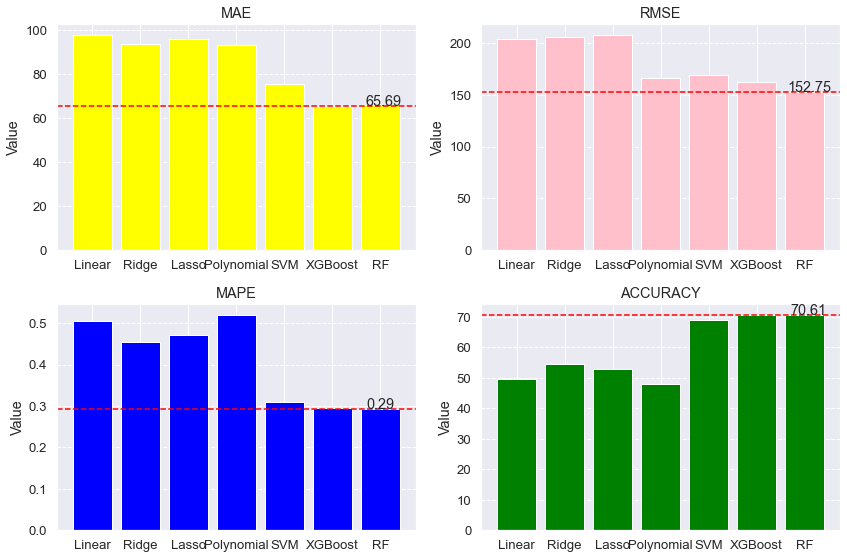

In [108]:
# Load the evaluation metrics data
models = ['Linear', 'Ridge', 'Lasso', 'Polynomial', 'SVM', 'XGBoost', 'RF']
mae = [MAE_1,MAE_2,MAE_3,MAE_4,MAE_5,MAE_6,MAE_7]
mse = [MSE_1,MSE_2,MSE_3,MSE_4,MSE_5,MSE_6,MSE_7]
rmse = [RMSE_1,RMSE_2,RMSE_3,RMSE_4,RMSE_5,RMSE_6,RMSE_7]
mape=[MAPE_1,MAPE_2,MAPE_3,MAPE_4,MAPE_5,MAPE_6,MAPE_7]
accuracy=[Accuracy_1,Accuracy_2,Accuracy_3,Accuracy_4,Accuracy_5,Accuracy_6,Accuracy_7]

# Create dataframe
df_performance = pd.DataFrame({'Model': models,  'MAE': mae,'MSE':mse,'RMSE':rmse,'MAPE':mape,'ACCURACY':accuracy})

# Set the Model column as the index
df_performance = df_performance.set_index('Model')

# Compute the minimum values of each metric
min_mae = df_performance['MAE'].min()
min_rmse = df_performance['RMSE'].min()
min_mape = df_performance['MAPE'].min()
max_accuracy = df_performance['ACCURACY'].max()

# Create subplots
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(12, 8))

# MAE
axs[0,0].bar(models, mae,color='yellow')
axs[0,0].set_title('MAE')
axs[0,0].set_ylabel('Value')
axs[0,0].axhline(min_mae, color='red', linestyle='--')
axs[0,0].text(5.7, min_mae, str(round(min_mae, 2)))
axs[0,0].grid(axis='y', linestyle='--')

# RMSE
axs[0,1].bar(models, rmse,color='pink')
axs[0,1].set_title('RMSE')
axs[0,1].set_ylabel('Value')
axs[0,1].axhline(min_rmse, color='red', linestyle='--')
axs[0,1].text(5.65, min_rmse, str(round(min_rmse, 2)))
axs[0,1].grid(axis='y', linestyle='--')

# MAPE
axs[1,0].bar(models, mape,color='blue')
axs[1,0].set_title('MAPE')
axs[1,0].set_ylabel('Value')
axs[1,0].axhline(min_mape, color='red', linestyle='--')
axs[1,0].text(5.7, min_mape, str(round(min_mape, 2)))
axs[1,0].grid(axis='y', linestyle='--')

# Accuracy
axs[1,1].bar(models, accuracy,color='green')
axs[1,1].set_title('ACCURACY')
axs[1,1].set_ylabel('Value')
axs[1,1].axhline(max_accuracy, color='red', linestyle='--')
axs[1,1].text(5.7, max_accuracy, str(round(max_accuracy, 2)))
axs[1,1].grid(axis='y', linestyle='--')

# adjust layout and show plot
plt.tight_layout()
plt.show()

The bar charts shown above represent the evaluation metrics of each model. We could see that both Random Forest and XGBoost had superior performance compared to the others. XGBoost performed slightly better on **MAE**, while Random Forest had much lower **RMSE** and higher **Accuracy**. Therefore, we will suggest the **Random Forest Regressor** model for further analysis, although XGBoost is also a good choice.

#### Feature Importance

The feature importance of the different variables in the models is then analysed.

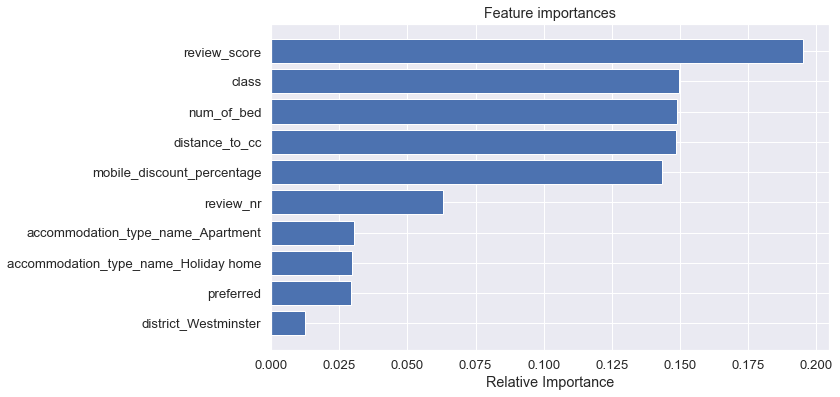

In [110]:
# Get feature importances from the rf model and sort them in ascending order
importances = rf.feature_importances_
indices = np.argsort(importances)
feature_names = df_regression.drop(columns='min_total_price').columns

# Plot a horizontal bar chart of the top 10 feature importances
plt.figure(figsize=(10, 6))
plt.title("Feature importances")
plt.barh(range(10), importances[indices][-10:], color="b", align="center")
plt.yticks(range(10), [feature_names[i] for i in indices][-10:])
plt.xlabel("Relative Importance")
plt.show()

We can see from the horizontal bar chart above that **review_score**, **class**, **num_of_bed**, **distance_to_cc** and **mobile_discount_percentage** have the biggest impact on our model. 

This provides insights into which variables are the most important for predicting hotel prices, and can help guide future feature engineering or data collection efforts. For example, known that **mobile_discount_percentage** is a significant factor in predicting hotel prices, hotels could consider adjusting their pricing strategies for mobile users.

## Conclusion <a id = '5'></a>

To summarise, in order to acquire insights into numerous facets of the hotel sector in this wonderful city, we examined a comprehensive data of hotels in London. Prior to doing a thorough data analysis, we cleaned and prepared the data. By conducting an in-depth analysis into the data, we obtained a number of intriguing results concerning the hotels in London.

We found valuable insights into the London hotel market, for example:
* The dominance of 3, 4, and 5-star hotels in London Hotel Market.
* The wide range of available accommodation types.
* Rating isn't a sufficient indicator for travellers.
* Most hotels prices are concentrated in the 75-200 range, with a few charge significantly higher prices, possibly due to the presence of luxury hotels or limited competition in the market.
* There are some areas famous for luxury hotels (e.g., Mayfair) and some for budgeted hotels (e.g., Paddington).
* There are significant differences in prices among different boroughs, and could be partly explained by factors (e.g., transport accessibility).
* Some hotels are with convenient location and decent review score, but with relatively affordable prices. (e.g. The Z Hotel Strand, NOX Waterloo).
* Looking into the positive reviews, guests have appreciated a lot for the convenient locations and the good service. 
* Guests have mainly complained about the noise, bathroom, room space, breakfast and service, based on the topic modelling for negative reviews. 
* Random Forest could be a competitive candidate for pricing prediction.
* Hotels could consider adjusting their pricing strategies for mobile users.

There are also several limitations and further actions to consider, for example:
* The data only covers a one time period, but prices and hotel features may change over time. Data could be collected in the form of time series of panel data for more in-depth analysis. 
* The analysis does not consider all possible factors that may affect hotel prices, such as local events and holidays. These factors could have a significant impact on hotel demand and pricing, and could be the subject of future research. 
* To increase more comparability, one possible direction is to expand the analysis to other cities or regions (e.g., New York, Paris) to compare the results and identify any peculiarities to London only.

In conclusion, this report provides valuable insights into the hotel industry in London, highlighting important trends and factors that affect hotel pricing and customer satisfaction. Our findings and the machine learning model can be used by hotel owners, industry professionals and travellers to make more informed decisions.

## References <a id = '6'></a>

GeeksforGeeks. (2022). Get the City, State, and Country names from Latitude and Longitude using Python. [online] Available at: https://www.geeksforgeeks.org/get-the-city-state-and-country-names-from-latitude-and-longitude-using-python/ [Accessed 4 Jan. 2023].<a id = 'r1'></a>

GeeksforGeeks. (2023). Removing stop words with NLTK in Python. [online] Available at: https://www.geeksforgeeks.org/removing-stop-words-nltk-python/ [Accessed 19 Feb. 2023].<a id = 'r2'></a>

Gensim Tutorial. (n.d.). [online] Available at: https://tedboy.github.io/nlps/gensim_tutorial/tutorial.html [Accessed 19 Feb. 2023].<a id = 'r3'></a>

House of Commons Library. (2022). Hospitality industry in the UK: pre-pandemic statistics. [online] Available at: https://commonslibrary.parliament.uk/research-briefings/cbp-9111/#:~:text=Hospitality%20industry%20in%20the%20UK%3A%20pre%2Dpandemic,in%20each%20country%20and%20region. [Accessed 24 Feb. 2023].<a id = 'r4'></a>

Kapadia, S. (2019). Topic Modeling in Python: Latent Dirichlet Allocation (LDA). [online] Towards Data Science. Available at: https://towardsdatascience.com/end-to-end-topic-modeling-in-python-latent-dirichlet-allocation-lda-35ce4ed6b3e0 [Accessed 18 Feb. 2023].<a id = 'r5'></a>

Plotly. (n.d.). Getting started with Plotly in Python. [online] Plotly. Available at: https://plotly.com/python/getting-started/ [Accessed 18 Feb. 2023].<a id = 'r6'></a>

spaCy. (n.d.). spaCy 101: Everything you need to know. [online] Available at: https://spacy.io/usage/spacy-101 [Accessed 19 Feb. 2023].<a id = 'r7'></a>